<a href="https://colab.research.google.com/github/sasidharvarada/Construction-Plan/blob/dev-venkatesh/FOR_9_NODES.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Basic

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from scipy.stats import pearsonr
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
!pip install gpx-converter
from gpx_converter import Converter
from tabulate import tabulate
from functools import reduce


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 kB 2.8 MB/s eta 0:00:00


In [2]:
import pandas as pd

def remove_timezone(dt):
    return dt.replace(tzinfo=None)

def renaming_columns_avg(df1, avg, node_type='Outside'):
    df1['created_at'] = df1['created_at'].apply(remove_timezone)
    df1['Date'] = df1['created_at'].dt.date
    df1['Time'] = df1['created_at'].dt.time
    df1['created_at'] = pd.to_datetime(df1['created_at'])
    df1.set_index("created_at", inplace=True)
    # Resample, calculating the mean for numeric columns
    df1_resampled = df1.select_dtypes(include=['float64', 'int64']).resample(avg, label='right', closed='right').mean().round(3)

    # Drop NaN columns
    df1_resampled = df1_resampled.dropna(axis=1, how='all')
    # Drop unnecessary columns
    df1_resampled = df1_resampled.drop(['entry_id'], axis=1)

    # Convert all columns except 'created_at' to numeric
    # numeric_cols = df1_resampled.columns.drop('Date').drop('Time')
    # df1_resampled[numeric_cols] = df1_resampled[numeric_cols].apply(pd.to_numeric, errors='coerce')

    if node_type == 'Bus':
        df1_resampled = df1_resampled.rename(columns={'field1': 'PM2.5', 'field2': 'PM10', 'field3': 'Temperature', 'field4': 'Rh'})
        df1_resampled = df1_resampled[df1_resampled['PM10'] < 1000]
    elif node_type == 'Inside':
        df1_resampled = df1_resampled.rename(columns={'field1': 'Temperature', 'field2': 'RH', 'field3': 'PM2.5', 'field4': 'PM10',
                                  'field5': 'CO', 'field6': 'NO2', 'field7': 'NH3'})
    elif node_type == 'Airveda':
        df1_resampled = df1_resampled.rename(columns={'field1': 'AQI', 'field2': 'PM10', 'field3': 'PM2.5', 'field4': 'CO', 'field5': 'NOX'})

    return df1_resampled






# Handling raw data

In [4]:
# Load data
bn1 = pd.read_csv('/content/Faculty_quarters.csv', parse_dates=['created_at'])
bn2 = pd.read_csv('/content/Football_ground.csv', parse_dates=['created_at'])
bn3 = pd.read_csv('/content/Main Gate.csv', parse_dates=['created_at'])
bn4 = pd.read_csv('/content/OBH.csv', parse_dates=['created_at'])
bn5 = pd.read_csv('/content/PH_4.csv', parse_dates=['created_at'])
bn6 = pd.read_csv('/content/Pump_house.csv', parse_dates=['created_at'])
bn7 = pd.read_csv('/content/T_hub.csv', parse_dates=['created_at'])
bn8 = pd.read_csv('/content/felicity.csv', parse_dates=['created_at'])
bn9 = pd.read_csv('/content/guest.csv', parse_dates=['created_at'])




In [5]:
bn1


,created_at,entry_id,field1,field2,PM2.5,PM10,field5,field6,field7
0,2024-09-10 22:00:16+05:30,4720247,28.60,78.52,3.4,11.9,53.17,NaN,NaN
1,2024-09-10 22:00:32+05:30,4720248,28.61,78.56,3.5,11.2,53.50,NaN,NaN
2,2024-09-10 22:01:18+05:30,4720249,28.55,78.80,3.2,11.1,53.17,NaN,NaN
3,2024-09-10 22:01:34+05:30,4720250,28.58,78.66,3.2,12.5,53.17,NaN,NaN
4,2024-09-10 22:02:18+05:30,4720251,28.55,78.51,3.3,12.4,53.33,NaN,NaN
...,...,...,...,...,...,...,...,...,...
4408,2024-09-12 11:57:01+05:30,4724655,28.93,72.37,9.2,13.7,49.95,NaN,NaN
4409,2024-09-12 11:58:00+05:30,4724656,28.90,72.47,8.7,12.6,49.79,NaN,NaN
4410,2024-09-12 11:58:44+05:30,4724657,28.87,72.52,9.1,13.4,49.95,NaN,NaN
4411,2024-09-12 11:58:59+05:30,4724658,28.88,72.52,9.8,15.4,50.27,NaN,NaN


In [6]:
bn2

,created_at,entry_id,field1,field2,PM2.5,PM10,field5,field6,field7
0,2024-09-10 22:00:25+05:30,3336021,28.61,82.84,3.7,10.8,49.31,NaN,NaN
1,2024-09-10 22:00:40+05:30,3336022,28.63,82.91,3.6,10.6,49.63,NaN,NaN
2,2024-09-10 22:01:26+05:30,3336023,28.71,82.46,3.7,11.4,78.63,NaN,NaN
3,2024-09-10 22:01:42+05:30,3336024,28.87,84.50,3.5,9.9,72.51,NaN,NaN
4,2024-09-10 22:02:26+05:30,3336025,28.85,82.08,3.8,10.2,49.47,NaN,NaN
...,...,...,...,...,...,...,...,...,...
4406,2024-09-12 11:57:32+05:30,3340427,28.76,76.94,10.8,16.2,52.37,NaN,NaN
4407,2024-09-12 11:57:47+05:30,3340428,28.76,76.89,10.8,16.4,53.17,NaN,NaN
4408,2024-09-12 11:58:47+05:30,3340429,28.81,76.81,10.6,16.0,52.53,NaN,NaN
4409,2024-09-12 11:59:33+05:30,3340430,28.73,76.92,10.9,16.9,51.88,NaN,NaN


In [7]:
bn3

,created_at,entry_id,field1,field2,PM2.5,PM10,field5,field6,field7
0,2024-09-10 22:00:03+05:30,3045259,29.40,73.89,3.6,12.4,3.54,NaN,NaN
1,2024-09-10 22:00:47+05:30,3045260,29.38,73.86,3.5,13.7,2.42,NaN,NaN
2,2024-09-10 22:01:03+05:30,3045261,29.38,73.87,3.7,12.2,2.74,NaN,NaN
3,2024-09-10 22:01:48+05:30,3045262,29.34,73.87,3.5,12.1,2.26,NaN,NaN
4,2024-09-10 22:02:03+05:30,3045263,29.36,73.84,3.5,12.4,3.54,NaN,NaN
...,...,...,...,...,...,...,...,...,...
3296,2024-09-12 11:54:18+05:30,3048555,30.23,66.04,7.9,11.3,2.26,NaN,NaN
3297,2024-09-12 11:54:34+05:30,3048556,30.24,66.00,7.5,9.6,1.93,NaN,NaN
3298,2024-09-12 11:57:03+05:30,3048557,30.43,65.48,7.3,8.2,2.42,NaN,NaN
3299,2024-09-12 11:57:17+05:30,3048558,30.44,65.40,7.2,10.1,2.09,NaN,NaN


In [8]:
bn4

,created_at,entry_id,field1,field2,PM2.5,PM10,field5,field6,field7,field8
0,2024-09-10 22:00:12+05:30,7846073,29.44,71.84,3.4,6.8,0.32,NaN,NaN,10-09-2024 16:30
1,2024-09-10 22:00:56+05:30,7846074,29.46,71.77,3.5,9.1,0.32,NaN,NaN,10-09-2024 16:30
2,2024-09-10 22:01:12+05:30,7846075,29.52,71.41,3.3,6.1,0.32,NaN,NaN,10-09-2024 16:31
3,2024-09-10 22:01:57+05:30,7846076,29.44,71.47,3.1,7.8,0.48,NaN,NaN,10-09-2024 16:31
4,2024-09-10 22:02:13+05:30,7846077,29.42,71.52,3.3,7.3,0.48,NaN,NaN,10-09-2024 16:32
...,...,...,...,...,...,...,...,...,...,...
4402,2024-09-12 11:57:28+05:30,7850475,28.70,69.99,9.2,10.2,0.64,NaN,NaN,12-09-2024 06:27
4403,2024-09-12 11:58:29+05:30,7850476,28.68,70.08,8.9,10.8,0.81,NaN,NaN,12-09-2024 06:28
4404,2024-09-12 11:58:45+05:30,7850477,28.71,70.06,8.8,9.7,0.64,NaN,NaN,12-09-2024 06:28
4405,2024-09-12 11:59:29+05:30,7850478,28.73,69.92,8.3,10.3,0.64,NaN,NaN,12-09-2024 06:29


In [9]:
bn5

,created_at,entry_id,field1,field2,PM2.5,PM10,field5
0,2024-09-10 22:00:14+05:30,936062,29.18,73.29,876.4,NaN,0.48
1,2024-09-10 22:00:59+05:30,936063,29.15,73.26,865.7,NaN,1.13
2,2024-09-10 22:01:14+05:30,936064,29.17,73.18,876.6,NaN,0.32
3,2024-09-10 22:01:58+05:30,936065,29.21,73.09,907.4,NaN,0.81
4,2024-09-10 22:02:14+05:30,936066,29.23,72.99,889.0,NaN,0.48
...,...,...,...,...,...,...,...
4398,2024-09-12 11:57:24+05:30,940460,29.05,68.85,11.1,14.6,0.48
4399,2024-09-12 11:57:39+05:30,940461,29.05,68.75,10.8,14.7,0.00
4400,2024-09-12 11:58:24+05:30,940462,29.05,68.85,11.1,15.3,3.38
4401,2024-09-12 11:58:39+05:30,940463,29.06,68.74,12.2,17.7,0.97


In [10]:
bn6

,created_at,entry_id,field1,field2,PM2.5,PM10,field5,field6,field7
0,2024-09-10 22:00:10+05:30,2731305,27.33,86.90,3.5,11.9,0.0,NaN,NaN
1,2024-09-10 22:00:25+05:30,2731306,27.39,86.44,4.0,15.4,0.0,NaN,NaN
2,2024-09-10 22:00:55+05:30,2731307,27.56,85.58,4.0,12.7,0.0,NaN,NaN
3,2024-09-10 22:01:11+05:30,2731308,27.62,85.19,3.2,8.9,0.0,NaN,NaN
4,2024-09-10 22:01:26+05:30,2731309,27.68,84.98,3.2,8.6,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...
6220,2024-09-12 11:58:39+05:30,2737525,29.11,73.52,9.0,13.9,0.0,NaN,NaN
6221,2024-09-12 11:58:54+05:30,2737526,29.15,73.44,10.0,15.6,0.0,NaN,NaN
6222,2024-09-12 11:59:10+05:30,2737527,29.19,73.33,10.0,16.6,0.0,NaN,NaN
6223,2024-09-12 11:59:40+05:30,2737528,29.19,73.25,9.4,15.0,0.0,NaN,NaN


In [11]:
bn7

,created_at,entry_id,field1,field2,PM2.5,PM10,field5,field6,field7
0,2024-09-10 22:00:33+05:30,4316061,28.49,76.31,2.3,9.4,59.30,NaN,NaN
1,2024-09-10 22:00:48+05:30,4316062,28.47,76.37,2.0,7.4,58.81,NaN,NaN
2,2024-09-10 22:01:33+05:30,4316063,28.43,76.51,2.3,8.0,60.26,NaN,NaN
3,2024-09-10 22:01:49+05:30,4316064,28.40,76.50,2.4,6.2,77.67,NaN,NaN
4,2024-09-10 22:02:34+05:30,4316065,28.49,77.07,2.5,5.6,62.68,NaN,NaN
...,...,...,...,...,...,...,...,...,...
4427,2024-09-12 11:57:47+05:30,4320488,28.88,70.23,5.2,9.0,58.81,NaN,NaN
4428,2024-09-12 11:58:31+05:30,4320489,28.88,70.22,4.8,7.7,58.81,NaN,NaN
4429,2024-09-12 11:58:46+05:30,4320490,28.89,70.25,5.1,7.7,58.65,NaN,NaN
4430,2024-09-12 11:59:31+05:30,4320491,28.88,70.23,5.2,9.6,58.49,NaN,NaN


In [12]:
bn8

,created_at,entry_id,field1,field2,PM2.5,PM10,field5,field6,field7
0,2024-09-10 22:00:40+05:30,8200587,29.08,76.79,3.2,9.2,51.40,NaN,NaN
1,2024-09-10 22:00:56+05:30,8200588,29.03,76.99,3.2,10.0,52.53,NaN,NaN
2,2024-09-10 22:01:38+05:30,8200589,29.11,76.55,3.3,9.1,78.47,NaN,NaN
3,2024-09-10 22:01:54+05:30,8200590,29.14,76.31,3.5,12.2,50.43,NaN,NaN
4,2024-09-10 22:02:38+05:30,8200591,29.24,76.20,3.5,11.6,79.76,NaN,NaN
...,...,...,...,...,...,...,...,...,...
4403,2024-09-12 11:57:07+05:30,8204990,30.42,66.32,9.0,12.7,57.20,NaN,NaN
4404,2024-09-12 11:57:51+05:30,8204991,30.45,66.47,9.3,14.8,57.04,NaN,NaN
4405,2024-09-12 11:58:07+05:30,8204992,30.59,65.96,8.9,14.2,57.20,NaN,NaN
4406,2024-09-12 11:58:52+05:30,8204993,30.74,65.45,9.2,15.4,55.59,NaN,NaN


In [13]:
bn9

,created_at,entry_id,field1,field2,PM2.5,PM10,field5,field6,field7
0,2024-09-10 22:00:28+05:30,3012474,28.47,78.32,17.2,19.0,52.37,NaN,NaN
1,2024-09-10 22:00:44+05:30,3012475,28.45,78.31,17.0,19.0,52.85,NaN,NaN
2,2024-09-10 22:01:29+05:30,3012476,28.40,78.50,16.9,18.8,53.66,NaN,NaN
3,2024-09-10 22:01:44+05:30,3012477,28.40,78.46,16.6,18.4,70.25,NaN,NaN
4,2024-09-10 22:02:30+05:30,3012478,28.50,78.31,16.5,18.5,96.84,NaN,NaN
...,...,...,...,...,...,...,...,...,...
4419,2024-09-12 11:57:30+05:30,3016893,29.51,68.77,14.7,19.6,47.53,NaN,NaN
4420,2024-09-12 11:58:15+05:30,3016894,29.53,68.68,14.9,19.4,47.05,NaN,NaN
4421,2024-09-12 11:58:30+05:30,3016895,29.51,68.59,15.2,20.0,48.02,NaN,NaN
4422,2024-09-12 11:59:14+05:30,3016896,29.56,68.56,15.1,19.3,47.21,NaN,NaN


In [14]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=bn1.index, y=bn1['PM10'], name='bn1'))
fig.add_trace(go.Scatter(x=bn2.index, y=bn2['PM10'], name='bn2'))
fig.add_trace(go.Scatter(x=bn3.index, y=bn3['PM10'], name='bn3'))
fig.add_trace(go.Scatter(x=bn4.index, y=bn4['PM10'], name='bn4'))
fig.add_trace(go.Scatter(x=bn5.index, y=bn5['PM10'], name='bn5'))
fig.add_trace(go.Scatter(x=bn6.index, y=bn6['PM10'], name='bn6'))
fig.add_trace(go.Scatter(x=bn7.index, y=bn7['PM10'], name='bn7'))
fig.add_trace(go.Scatter(x=bn8.index, y=bn8['PM10'], name='bn8'))
fig.add_trace(go.Scatter(x=bn9.index, y=bn9['PM10'], name='bn9'))


fig.update_layout(title='Raw data PM10')
fig.update_xaxes()
fig.show()


In [15]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=bn1.index, y=bn1['PM2.5'], name='bn1'))
fig.add_trace(go.Scatter(x=bn2.index, y=bn2['PM2.5'], name='bn2'))
fig.add_trace(go.Scatter(x=bn3.index, y=bn3['PM2.5'], name='bn3'))
fig.add_trace(go.Scatter(x=bn4.index, y=bn4['PM2.5'], name='bn4'))
fig.add_trace(go.Scatter(x=bn5.index, y=bn5['PM2.5'], name='bn5'))
fig.add_trace(go.Scatter(x=bn6.index, y=bn6['PM2.5'], name='bn6'))
fig.add_trace(go.Scatter(x=bn7.index, y=bn7['PM2.5'], name='bn7'))
fig.add_trace(go.Scatter(x=bn8.index, y=bn8['PM2.5'], name='bn8'))
fig.add_trace(go.Scatter(x=bn9.index, y=bn9['PM2.5'], name='bn9'))



fig.update_layout(title='Raw data PM2.5')
fig.update_xaxes()
fig.show()

# Removing Outliers

In [17]:
# Initialize empty DataFrames for further processing
bn_1 = pd.DataFrame()
bn_2 = pd.DataFrame()
bn_3 = pd.DataFrame()
bn_4 = pd.DataFrame()
bn_5 = pd.DataFrame()
bn_6 = pd.DataFrame()
bn_7 = pd.DataFrame()
bn_8 = pd.DataFrame()
bn_9 = pd.DataFrame()



In [18]:
# Assign names to DataFrames
bn1.name = 'bn1'
bn2.name = 'bn2'
bn3.name = 'bn3'
bn4.name = 'bn4'
bn5.name = 'bn5'
bn6.name = 'bn6'
bn7.name = 'bn7'
bn8.name = 'bn8'
bn9.name = 'bn9'

In [24]:

def outlier_removal(df, column_name, max_col_val, verbose=True, node_type='Inside'):


# calculate summary statistics

#     lc3_mean, lc3_std = np.mean(df[column_name]), np.std(df[column_name])

#     # identify outliers
#     cut_off = lc3_std * 3
#     lower, upper = lc3_mean - cut_off, lc3_mean + cut_off
#     #identifying outliers
#     outliers = [x for x in df[column_name] if x < lower or x > upper]
#     # remove outliers
#     outliers_removed = [x for x in df[column_name] if x > lower and x < upper]

#     uu_1  = df[df[column_name] > lower]
#     new_df = uu_1[uu_1[column_name] < upper]
    df = df[df[column_name]< max_col_val]
    # if Node_type == 'Outside':
    #     df = df[df['RH']<85]
    q25, q75 = np.percentile(df[column_name], 25), np.percentile(df[column_name], 75)
    iqr = q75 - q25
    # calculate the outlier cutoff
    cut_off = iqr * 1.5
    lower, upper = q25 - cut_off, q75 + cut_off

    #identifying outliers
    outliers = [x for x in df[column_name] if x < lower or x > upper]

    # remove outliers
    outliers_removed = [x for x in df[column_name] if x > lower and x < upper]
    uu_1  = df[df[column_name] > lower]
    new_df = uu_1[uu_1[column_name] < upper]

    if verbose == True:
        print("cut off: ", cut_off)
        print("lower and upper boundaries: ", round(lower, 2), round(upper,2))
        #print("mean and standard deviation: ", lc3_mean, lc3_std)
        print('Identified outliers: %d' % len(outliers))
        print('Non-outlier observations: %d' % len(outliers_removed))
        print("q25,q75 ", q25, q75)

    return cut_off,round(lower, 2), round(upper,2), q25, q75, len(outliers),len(outliers_removed),new_df


In [26]:
dfs = [bn1, bn2, bn3, bn4, bn5, bn6, bn7, bn8, bn9]
new_dfs = [bn_1, bn_2, bn_3, bn_4, bn_5, bn_6, bn_7, bn_8, bn_9]
dfs_s = ['bn1', 'bn2', 'bn3', 'bn4', 'bn5', 'bn6', 'bn7', 'bn8', 'bn9']
new_dfs_s = ['bn_1', 'bn_2', 'bn_3', 'bn_4', 'bn_5', 'bn_6', 'bn_7', 'bn_8', 'bn_9']
nout = []
out = []

head = ["Node", "Cut_off", "Lower", "Upper", "Q25", "Q75", 'Outliers', "Non-out", "New_df"]
for i in range(len(dfs)):
    try:
        # Drop completely empty columns
        dfs[i] = dfs[i].dropna(axis=1, how='all')

        # Check if the dataframe is empty after dropping columns
        if dfs[i].empty:
            print(f"Dataframe {dfs_s[i]} is empty. Skipping to next dataframe...")
            continue

        cut_off, lower_bdry, upper_bdry, q25, q75, outlier, non_outlier, new_df = outlier_removal(dfs[i], column_name='PM10', max_col_val=999, verbose=False)
        new_dfs[i] = pd.concat([new_dfs[i], new_df], ignore_index=True)
        nout.append(non_outlier)
        out.append(outlier)


        mydata = [[dfs_s[i], cut_off, lower_bdry, upper_bdry, q25, q75, outlier, non_outlier, new_dfs_s[i]]]

        print(tabulate(mydata, headers=head, tablefmt="grid"))
        new_df.to_csv(f'{new_dfs_s[i]}_without_outliers.csv', index=False)
    except KeyError as e:
        print(f"KeyError occurred for dataframe {dfs_s[i]}: {e}. Skipping to next dataframe...")

print("non-outliers:", sum(nout))
print("outliers:", sum(out))




# dfs = [bn1, bn2, bn3, bn4]
# new_dfs = [bn_1, bn_2, bn_3, bn_4]
# dfs_s = ['bn1', 'bn2', 'bn3', 'bn4']
# new_dfs_s = ['bn_1', 'bn_2', 'bn_3', 'bn_4']
# nout = []
# out = []

# head = ["Node", "Cut_off", "Lower", "Upper", "Q25", "Q75", 'Outliers', "Non-out", "New_df"]
# for i in range(len(dfs)):
#     try:
#         # Drop completely empty columns
#         dfs[i] = dfs[i].dropna(axis=1, how='all')

#         # Check if the dataframe is empty after dropping columns
#         if dfs[i].empty:
#             print(f"Dataframe {dfs_s[i]} is empty. Skipping to next dataframe...")
#             continue

#         cut_off, lower_bdry, upper_bdry, q25, q75, outlier, non_outlier, new_df = outlier_removal(dfs[i], column_name='PM10', max_col_val=999, verbose=False)
#         new_dfs[i] = new_dfs[i].append(new_df)
#         nout.append(non_outlier)
#         out.append(outlier)

#         mydata = [[dfs_s[i], cut_off, lower_bdry, upper_bdry, q25, q75, outlier, non_outlier, new_dfs_s[i]]]

#         print(tabulate(mydata, headers=head, tablefmt="grid"))
#         new_df.to_csv(f'{new_dfs_s[i]}_without_outliers.csv', index=False)
#     except KeyError as e:
#         print(f"KeyError occurred for dataframe {dfs_s[i]}: {e}. Skipping to next dataframe...")

# print("non-outliers:", sum(nout))
# print("outliers:", sum(out))

+--------+-----------+---------+---------+-------+-------+------------+-----------+----------+
| Node   |   Cut_off |   Lower |   Upper |   Q25 |   Q75 |   Outliers |   Non-out | New_df   |
+========+===========+=========+=========+=======+=======+============+===========+==========+
| bn1    |       5.4 |     2.7 |    17.1 |   8.1 |  11.7 |          0 |      4413 | bn_1     |
+--------+-----------+---------+---------+-------+-------+------------+-----------+----------+
+--------+-----------+---------+---------+-------+-------+------------+-----------+----------+
| Node   |   Cut_off |   Lower |   Upper |   Q25 |   Q75 |   Outliers |   Non-out | New_df   |
+========+===========+=========+=========+=======+=======+============+===========+==========+
| bn2    |         6 |     2.7 |    18.7 |   8.7 |  12.7 |          0 |      4411 | bn_2     |
+--------+-----------+---------+---------+-------+-------+------------+-----------+----------+
+--------+-----------+---------+---------+-------+

# Handling modified files (Without Outliers)

In [27]:
bn_1_without_outliers= pd.read_csv('/content/bn_1_without_outliers.csv', parse_dates = ['created_at'])
bn_2_without_outliers = pd.read_csv('/content/bn_2_without_outliers.csv', parse_dates = ['created_at'])
bn_3_without_outliers = pd.read_csv('/content/bn_3_without_outliers.csv', parse_dates = ['created_at'])
bn_4_without_outliers = pd.read_csv('/content/bn_4_without_outliers.csv', parse_dates = ['created_at'])
bn_5_without_outliers = pd.read_csv('/content/bn_4_without_outliers.csv', parse_dates = ['created_at'])
bn_6_without_outliers = pd.read_csv('/content/bn_4_without_outliers.csv', parse_dates = ['created_at'])
bn_7_without_outliers = pd.read_csv('/content/bn_4_without_outliers.csv', parse_dates = ['created_at'])
bn_8_without_outliers = pd.read_csv('/content/bn_4_without_outliers.csv', parse_dates = ['created_at'])
bn_9_without_outliers = pd.read_csv('/content/bn_4_without_outliers.csv', parse_dates = ['created_at'])

In [28]:
BN1 = renaming_columns_avg(bn_1_without_outliers, 'T', 'Inside')
BN2 = renaming_columns_avg(bn_2_without_outliers, 'T', 'Inside')
BN3 = renaming_columns_avg(bn_3_without_outliers, 'T', 'Inside')
BN4 = renaming_columns_avg(bn_4_without_outliers, 'T', 'Inside')
BN5 = renaming_columns_avg(bn_5_without_outliers, 'T', 'Inside')
BN6 = renaming_columns_avg(bn_6_without_outliers, 'T', 'Inside')
BN7 = renaming_columns_avg(bn_7_without_outliers, 'T', 'Inside')
BN8 = renaming_columns_avg(bn_8_without_outliers, 'T', 'Inside')
BN9 = renaming_columns_avg(bn_9_without_outliers, 'T', 'Inside')

In [45]:
BN1

,Temperature,RH,PM2.5,PM10,CO
created_at,,,,,
2024-09-10 22:01:00,28.605,78.540,3.45,11.55,53.335
2024-09-10 22:02:00,28.565,78.730,3.20,11.80,53.170
2024-09-10 22:03:00,28.590,78.475,3.40,11.40,53.250
2024-09-10 22:04:00,28.595,78.155,3.55,11.70,54.540
2024-09-10 22:05:00,28.650,78.080,3.40,11.60,53.250
...,...,...,...,...,...
2024-09-12 11:56:00,28.900,72.390,9.00,15.10,50.920
2024-09-12 11:57:00,28.920,72.375,9.15,15.90,50.920
2024-09-12 11:58:00,28.915,72.420,8.95,13.15,49.870


In [44]:
BN2

,Temperature,RH,PM2.5,PM10,CO
created_at,,,,,
2024-09-10 22:01:00,28.620,82.875,3.65,10.70,49.470
2024-09-10 22:02:00,28.790,83.480,3.60,10.65,75.570
2024-09-10 22:03:00,28.865,82.015,3.85,10.30,51.885
2024-09-10 22:04:00,29.020,82.465,3.65,10.75,58.735
2024-09-10 22:05:00,29.045,80.715,3.65,10.15,51.400
...,...,...,...,...,...
2024-09-12 11:56:00,28.760,76.890,10.80,16.10,52.370
2024-09-12 11:57:00,28.730,77.030,11.00,16.90,52.365
2024-09-12 11:58:00,28.760,76.915,10.80,16.30,52.770


In [46]:
BN3

,Temperature,RH,PM2.5,PM10,CO
created_at,,,,,
2024-09-10 22:01:00,29.390,73.875,3.55,13.05,2.980
2024-09-10 22:02:00,29.360,73.870,3.60,12.15,2.500
2024-09-10 22:03:00,29.340,73.890,3.45,11.15,3.220
2024-09-10 22:04:00,29.325,73.950,3.65,12.25,2.500
2024-09-10 22:05:00,29.295,73.975,3.55,14.15,2.575
...,...,...,...,...,...
2024-09-12 11:56:00,NaN,NaN,NaN,NaN,NaN
2024-09-12 11:57:00,NaN,NaN,NaN,NaN,NaN
2024-09-12 11:58:00,30.435,65.440,7.25,9.15,2.255


In [47]:
BN4

,Temperature,RH,PM2.5,PM10,CO
created_at,,,,,
2024-09-10 22:01:00,29.450,71.805,3.45,7.95,0.320
2024-09-10 22:02:00,29.480,71.440,3.20,6.95,0.400
2024-09-10 22:03:00,29.355,71.880,3.25,7.05,0.400
2024-09-10 22:04:00,29.300,72.110,2.80,6.80,0.560
2024-09-10 22:05:00,29.295,71.945,2.25,4.40,1.125
...,...,...,...,...,...
2024-09-12 11:56:00,28.775,69.800,8.75,9.70,0.565
2024-09-12 11:57:00,28.735,69.920,8.35,9.20,0.480
2024-09-12 11:58:00,28.700,69.990,9.20,10.20,0.640


In [48]:
BN5

,Temperature,RH,PM2.5,PM10,CO
created_at,,,,,
2024-09-10 22:01:00,29.450,71.805,3.45,7.95,0.320
2024-09-10 22:02:00,29.480,71.440,3.20,6.95,0.400
2024-09-10 22:03:00,29.355,71.880,3.25,7.05,0.400
2024-09-10 22:04:00,29.300,72.110,2.80,6.80,0.560
2024-09-10 22:05:00,29.295,71.945,2.25,4.40,1.125
...,...,...,...,...,...
2024-09-12 11:56:00,28.775,69.800,8.75,9.70,0.565
2024-09-12 11:57:00,28.735,69.920,8.35,9.20,0.480
2024-09-12 11:58:00,28.700,69.990,9.20,10.20,0.640


In [49]:
BN6

,Temperature,RH,PM2.5,PM10,CO
created_at,,,,,
2024-09-10 22:01:00,29.450,71.805,3.45,7.95,0.320
2024-09-10 22:02:00,29.480,71.440,3.20,6.95,0.400
2024-09-10 22:03:00,29.355,71.880,3.25,7.05,0.400
2024-09-10 22:04:00,29.300,72.110,2.80,6.80,0.560
2024-09-10 22:05:00,29.295,71.945,2.25,4.40,1.125
...,...,...,...,...,...
2024-09-12 11:56:00,28.775,69.800,8.75,9.70,0.565
2024-09-12 11:57:00,28.735,69.920,8.35,9.20,0.480
2024-09-12 11:58:00,28.700,69.990,9.20,10.20,0.640


In [50]:
BN7

,Temperature,RH,PM2.5,PM10,CO
created_at,,,,,
2024-09-10 22:01:00,29.450,71.805,3.45,7.95,0.320
2024-09-10 22:02:00,29.480,71.440,3.20,6.95,0.400
2024-09-10 22:03:00,29.355,71.880,3.25,7.05,0.400
2024-09-10 22:04:00,29.300,72.110,2.80,6.80,0.560
2024-09-10 22:05:00,29.295,71.945,2.25,4.40,1.125
...,...,...,...,...,...
2024-09-12 11:56:00,28.775,69.800,8.75,9.70,0.565
2024-09-12 11:57:00,28.735,69.920,8.35,9.20,0.480
2024-09-12 11:58:00,28.700,69.990,9.20,10.20,0.640


In [51]:
BN8

,Temperature,RH,PM2.5,PM10,CO
created_at,,,,,
2024-09-10 22:01:00,29.450,71.805,3.45,7.95,0.320
2024-09-10 22:02:00,29.480,71.440,3.20,6.95,0.400
2024-09-10 22:03:00,29.355,71.880,3.25,7.05,0.400
2024-09-10 22:04:00,29.300,72.110,2.80,6.80,0.560
2024-09-10 22:05:00,29.295,71.945,2.25,4.40,1.125
...,...,...,...,...,...
2024-09-12 11:56:00,28.775,69.800,8.75,9.70,0.565
2024-09-12 11:57:00,28.735,69.920,8.35,9.20,0.480
2024-09-12 11:58:00,28.700,69.990,9.20,10.20,0.640


In [52]:
BN9

,Temperature,RH,PM2.5,PM10,CO
created_at,,,,,
2024-09-10 22:01:00,29.450,71.805,3.45,7.95,0.320
2024-09-10 22:02:00,29.480,71.440,3.20,6.95,0.400
2024-09-10 22:03:00,29.355,71.880,3.25,7.05,0.400
2024-09-10 22:04:00,29.300,72.110,2.80,6.80,0.560
2024-09-10 22:05:00,29.295,71.945,2.25,4.40,1.125
...,...,...,...,...,...
2024-09-12 11:56:00,28.775,69.800,8.75,9.70,0.565
2024-09-12 11:57:00,28.735,69.920,8.35,9.20,0.480
2024-09-12 11:58:00,28.700,69.990,9.20,10.20,0.640


In [ ]:
# If not required, commented out
# BN1 = BN1.drop(['Temperature', 'RH'], axis=1)
# BN2 = BN2.drop(['Temperature', 'RH'], axis=1)


In [53]:
# Create a figure
fig = go.Figure()

# Add scatter traces for each coluBN
fig.add_trace(go.Scatter(x=BN1.index, y=BN1['PM10'], name='BN1_without_outliers'))
fig.add_trace(go.Scatter(x=BN2.index, y=BN2['PM10'], name='BN2_without_outliers'))
fig.add_trace(go.Scatter(x=BN3.index, y=BN3['PM10'], name='BN3_without_outliers'))
fig.add_trace(go.Scatter(x=BN4.index, y=BN4['PM10'], name='BN4_without_outliers'))
fig.add_trace(go.Scatter(x=BN5.index, y=BN5['PM10'], name='BN5_without_outliers'))
fig.add_trace(go.Scatter(x=BN6.index, y=BN6['PM10'], name='BN6_without_outliers'))
fig.add_trace(go.Scatter(x=BN7.index, y=BN7['PM10'], name='BN7_without_outliers'))
fig.add_trace(go.Scatter(x=BN8.index, y=BN8['PM10'], name='BN8_without_outliers'))
fig.add_trace(go.Scatter(x=BN9.index, y=BN9['PM10'], name='BN9_without_outliers'))

# Add more traces for additional coluBNs as needed

# Update layout
fig.update_layout(title='Outdoor Nodes')
fig.update_xaxes()
# Show the plot
fig.show()

In [54]:
# Create a figure
fig = go.Figure()

# Add scatter traces for each coluBN
fig.add_trace(go.Scatter(x=BN1.index, y=BN1['PM2.5'], name='BN1_without_outliers'))
fig.add_trace(go.Scatter(x=BN2.index, y=BN2['PM2.5'], name='BN2_without_outliers'))
fig.add_trace(go.Scatter(x=BN3.index, y=BN3['PM2.5'], name='BN3_without_outliers'))
fig.add_trace(go.Scatter(x=BN4.index, y=BN4['PM2.5'], name='BN4_without_outliers'))
fig.add_trace(go.Scatter(x=BN5.index, y=BN5['PM2.5'], name='BN5_without_outliers'))
fig.add_trace(go.Scatter(x=BN6.index, y=BN6['PM2.5'], name='BN6_without_outliers'))
fig.add_trace(go.Scatter(x=BN7.index, y=BN7['PM2.5'], name='BN7_without_outliers'))
fig.add_trace(go.Scatter(x=BN8.index, y=BN8['PM2.5'], name='BN8_without_outliers'))
fig.add_trace(go.Scatter(x=BN9.index, y=BN9['PM2.5'], name='BN9_without_outliers'))

# Add more traces for additional coluBNs as needed

# Update layout
fig.update_layout(title='PM2.5 without Outliers')
fig.update_xaxes()
# Show the plot
fig.show()

# Handling Aeroqual Data

In [31]:
aero = pd.read_csv("/content/10_09_24_to_12_09_24 - 10_09_24_to_12_09_24.csv")

In [32]:
aero

,Date Time,Monitor ID,Location ID,PM10(ppm),PM2.5(ppm)
0,10 Sep 2024 22:27,2,1,0.008,0.004
1,10 Sep 2024 22:28,2,1,0.007,0.004
2,10 Sep 2024 22:29,2,1,0.008,0.004
3,10 Sep 2024 22:30,2,1,0.009,0.004
4,10 Sep 2024 22:31,2,1,0.011,0.004
...,...,...,...,...,...
2361,12 Sep 2024 13:48,2,1,0.013,0.010
2362,12 Sep 2024 13:49,2,1,0.016,0.008
2363,12 Sep 2024 13:50,2,1,0.012,0.007
2364,12 Sep 2024 13:51,2,1,0.014,0.007


In [33]:
aero = aero.rename(columns = {'Date Time': 'created_at'})
aero['created_at'] = pd.to_datetime(aero['created_at'], dayfirst = True)

In [35]:
aero.dtypes
aero = aero.drop(['Monitor ID', 'Location ID'], axis=1)

In [61]:
aero['PM10_ppb'] = aero['PM10(ppm)']*1000
aero['PM2.5_ppb'] = aero['PM2.5(ppm)']*1000

In [62]:
aero

,created_at,PM10(ppm),PM2.5(ppm),PM10_ppb,PM2.5_ppb
0,2024-09-10 22:27:00,0.008,0.004,8.0,4.0
1,2024-09-10 22:28:00,0.007,0.004,7.0,4.0
2,2024-09-10 22:29:00,0.008,0.004,8.0,4.0
3,2024-09-10 22:30:00,0.009,0.004,9.0,4.0
4,2024-09-10 22:31:00,0.011,0.004,11.0,4.0
...,...,...,...,...,...
2361,2024-09-12 13:48:00,0.013,0.010,13.0,10.0
2362,2024-09-12 13:49:00,0.016,0.008,16.0,8.0
2363,2024-09-12 13:50:00,0.012,0.007,12.0,7.0
2364,2024-09-12 13:51:00,0.014,0.007,14.0,7.0


In [63]:
# Save modified Aero data to CSV
aero_modified_filename = 'modified_aero.csv'
aero.to_csv(aero_modified_filename, index=False)
print(f"Modified Aero data saved as {aero_modified_filename}")

Modified Aero data saved as modified_aero.csv


In [64]:
# Create a figure
fig = go.Figure()

# Add scatter traces for each coluBN
fig.add_trace(go.Scatter(x=BN1.index, y=BN1['PM10'], name='BN1_without_outliers'))
fig.add_trace(go.Scatter(x=BN2.index, y=BN2['PM10'], name='BN2_without_outliers'))
fig.add_trace(go.Scatter(x=BN3.index, y=BN3['PM10'], name='BN3_without_outliers'))
fig.add_trace(go.Scatter(x=BN4.index, y=BN4['PM10'], name='BN4_without_outliers'))
fig.add_trace(go.Scatter(x=BN5.index, y=BN5['PM10'], name='BN5_without_outliers'))
fig.add_trace(go.Scatter(x=BN6.index, y=BN6['PM10'], name='BN6_without_outliers'))
fig.add_trace(go.Scatter(x=BN7.index, y=BN7['PM10'], name='BN7_without_outliers'))
fig.add_trace(go.Scatter(x=BN8.index, y=BN8['PM10'], name='BN8_without_outliers'))
fig.add_trace(go.Scatter(x=BN9.index, y=BN9['PM10'], name='BN9_without_outliers'))
fig.add_trace(go.Scatter(x=aero['created_at'], y=aero['PM10_ppb'], name='aero'))
# Add more traces for additional coluBNs as needed

# Update layout
fig.update_layout(title='Outdoor Nodes')
# fig.update_xaxes(rangeslider_visible=True)
fig.update_xaxes()

# Show the plot
fig.show()

/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [65]:
# Create a figure
fig = go.Figure()

# Add scatter traces for each coluBN
fig.add_trace(go.Scatter(x=BN1.index, y=BN1['PM2.5'], name='BN1_without_outliers'))
fig.add_trace(go.Scatter(x=BN2.index, y=BN2['PM2.5'], name='BN2_without_outliers'))
fig.add_trace(go.Scatter(x=BN3.index, y=BN3['PM2.5'], name='BN3_without_outliers'))
fig.add_trace(go.Scatter(x=BN4.index, y=BN4['PM2.5'], name='BN4_without_outliers'))
fig.add_trace(go.Scatter(x=BN5.index, y=BN5['PM2.5'], name='BN5_without_outliers'))
fig.add_trace(go.Scatter(x=BN6.index, y=BN6['PM2.5'], name='BN6_without_outliers'))
fig.add_trace(go.Scatter(x=BN7.index, y=BN7['PM2.5'], name='BN7_without_outliers'))
fig.add_trace(go.Scatter(x=BN8.index, y=BN8['PM2.5'], name='BN8_without_outliers'))
fig.add_trace(go.Scatter(x=BN9.index, y=BN9['PM2.5'], name='BN9_without_outliers'))
fig.add_trace(go.Scatter(x=aero['created_at'], y=aero['PM2.5_ppb'], name='aero'))
# Add more traces for additional coluBNs as needed

# Update layout
fig.update_layout(title='Outdoor Nodes')
# fig.update_xaxes(rangeslider_visible=True)
fig.update_xaxes()

# Show the plot
fig.show()

# Handling shift/Lag

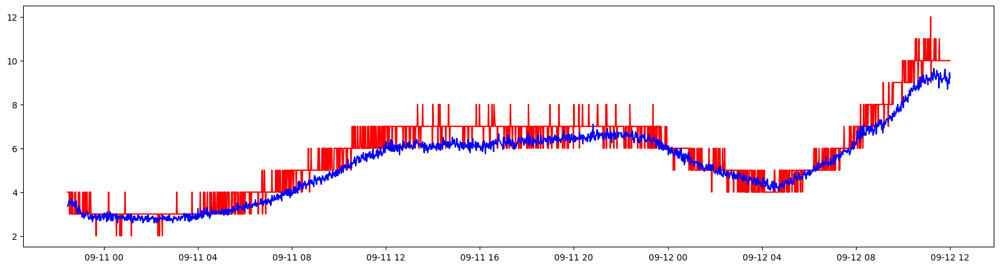

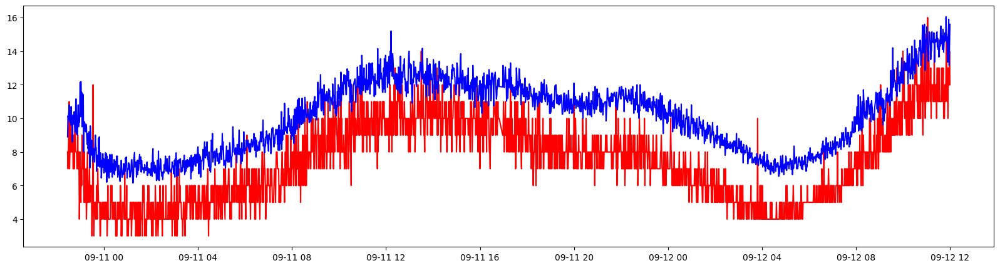

In [57]:
a1 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN1])
a1 = a1.dropna()
x = a1['created_at']
y1 = a1['PM2.5_ppb']
y2 = a1['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,y1,'r')
plt.plot(x,y2,'b')

x = a1['created_at']
y3 = a1['PM10_ppb']
y4 = a1['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,y3,'r')
plt.plot(x,y4,'b')

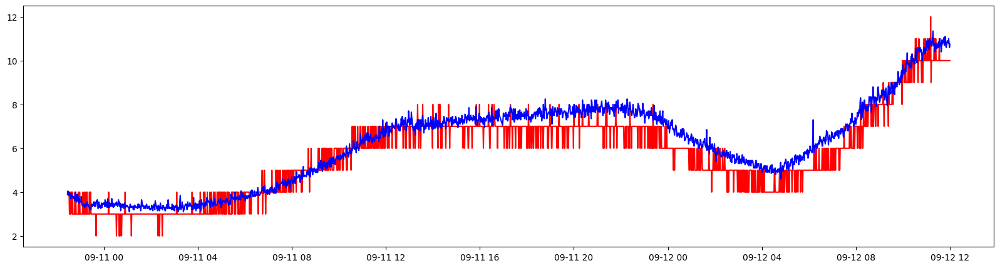

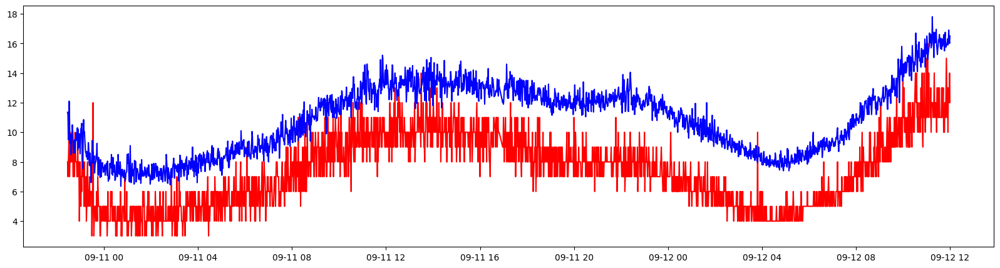

In [58]:
a2 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN2])
a2 = a2.dropna()
a2 = a2[a2['PM2.5'] <= 999]
x = a2['created_at']
z1 = a2['PM2.5_ppb']
z2 = a2['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z1,'r')
plt.plot(x,z2,'b')

x = a2['created_at']
z3 = a2['PM10_ppb']
z4 = a2['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z3,'r')
plt.plot(x,z4,'b')

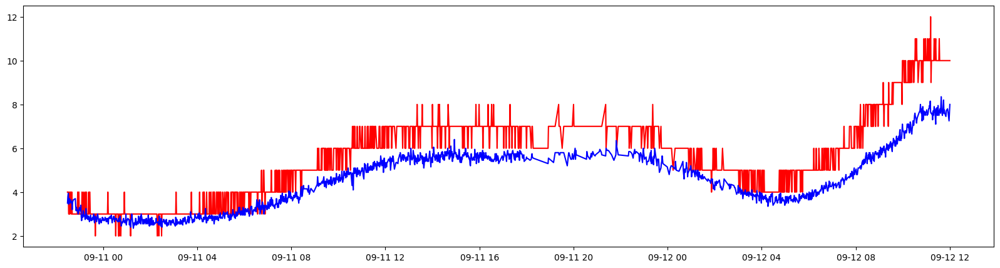

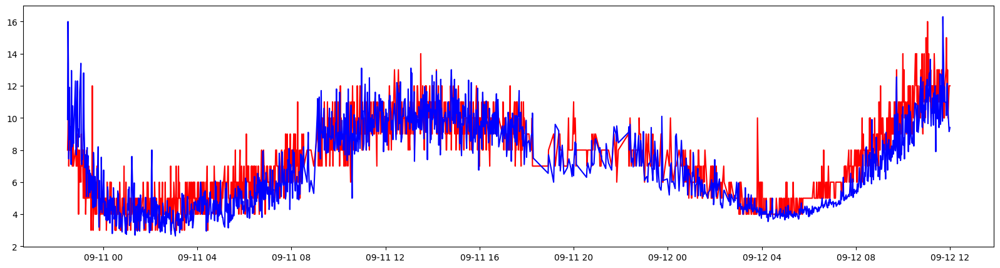

In [66]:
a3 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN3])
a3 = a3.dropna()
x = a3['created_at']
s1 = a3['PM2.5_ppb']
s2 = a3['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,s1,'r')
plt.plot(x,s2,'b')

x = a3['created_at']
s3 = a3['PM10_ppb']
s4 = a3['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,s3,'r')
plt.plot(x,s4,'b')

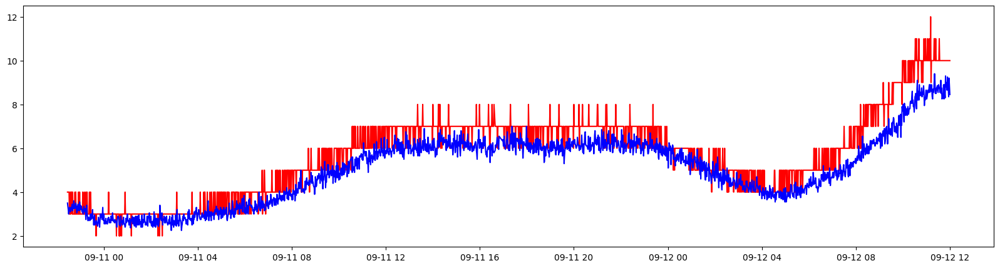

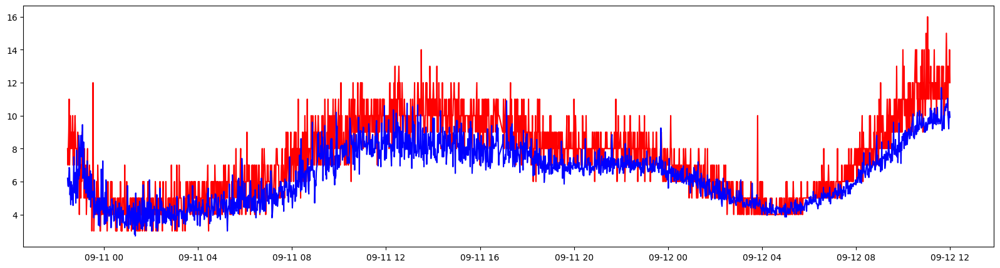

In [67]:
a4 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN4])
a4 = a4.dropna()
x = a4['created_at']
t1 = a4['PM2.5_ppb']
t2 = a4['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,t1,'r')
plt.plot(x,t2,'b')

x = a4['created_at']
t3 = a4['PM10_ppb']
t4 = a4['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,t3,'r')
plt.plot(x,t4,'b')

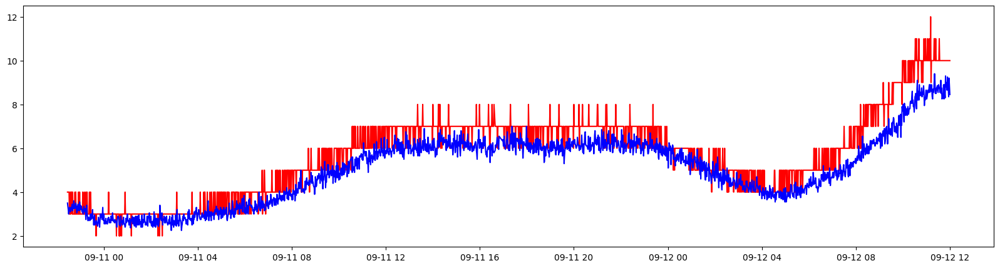

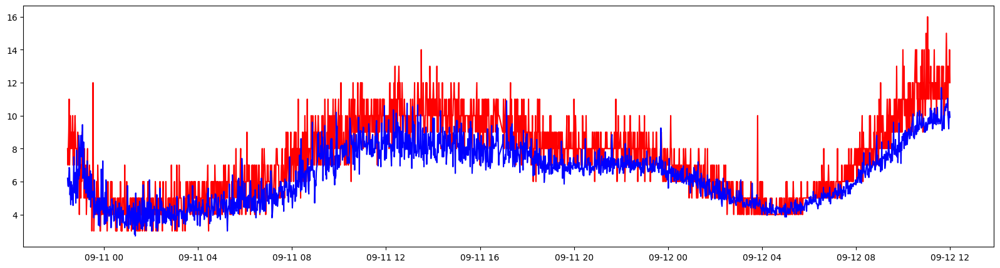

In [70]:
a5 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN5])
a5 = a5.dropna()
x = a5['created_at']
r1 = a5['PM2.5_ppb']
r2 = a5['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,r1,'r')
plt.plot(x,r2,'b')

x = a5['created_at']
r3 = a5['PM10_ppb']
r4 = a5['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,r3,'r')
plt.plot(x,r4,'b')

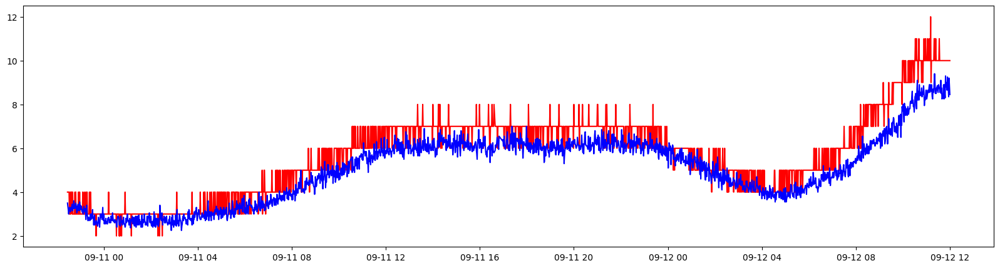

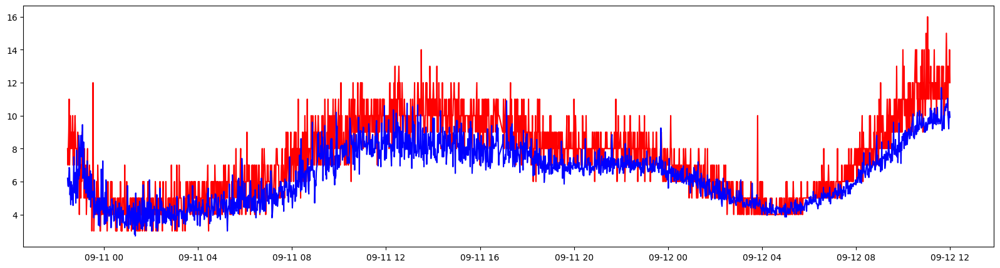

In [71]:
a6 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN6])
a6 = a6.dropna()
x = a6['created_at']
v1 = a6['PM2.5_ppb']
v2 = a6['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,v1,'r')
plt.plot(x,v2,'b')

x = a6['created_at']
v3 = a6['PM10_ppb']
v4 = a6['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,v3,'r')
plt.plot(x,v4,'b')

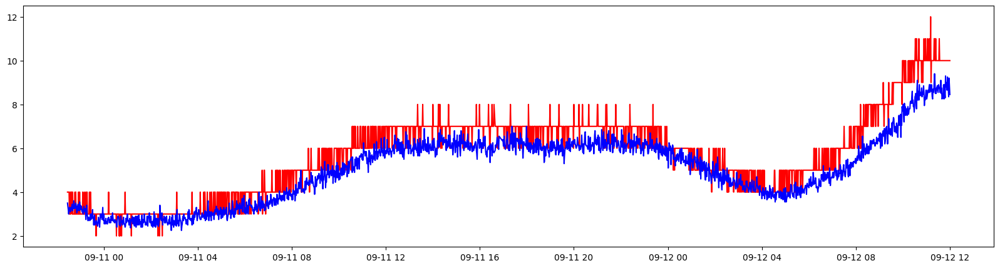

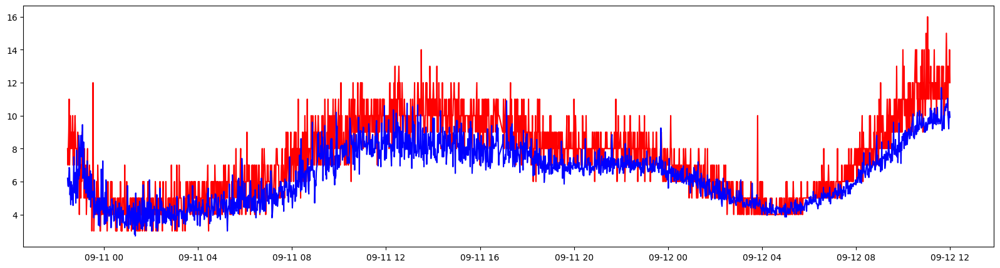

In [72]:
a7 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN7])
a7 = a7.dropna()
x = a7['created_at']
p1 = a7['PM2.5_ppb']
p2 = a7['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,p1,'r')
plt.plot(x,p2,'b')

x = a7['created_at']
p3 = a7['PM10_ppb']
p4 = a7['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,p3,'r')
plt.plot(x,p4,'b')

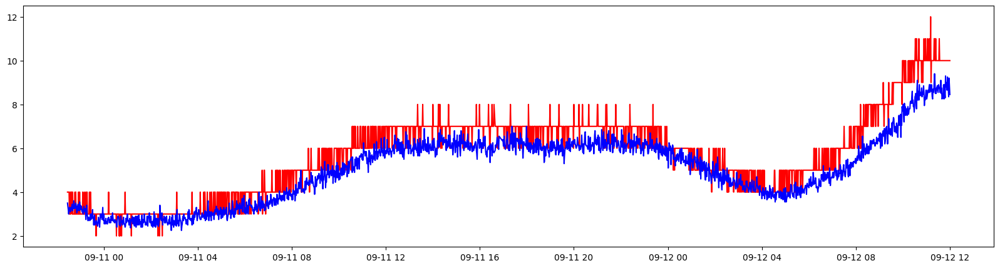

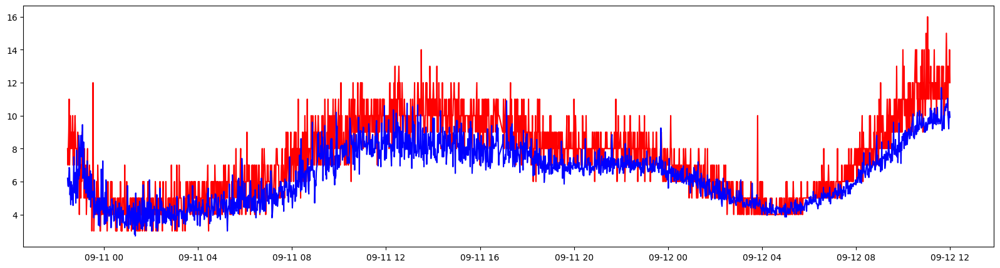

In [73]:
a8 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN8])
a8 = a8.dropna()
x = a8['created_at']
m1 = a8['PM2.5_ppb']
m2 = a8['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,m1,'r')
plt.plot(x,m2,'b')

x = a8['created_at']
m3 = a8['PM10_ppb']
m4 = a8['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,m3,'r')
plt.plot(x,m4,'b')

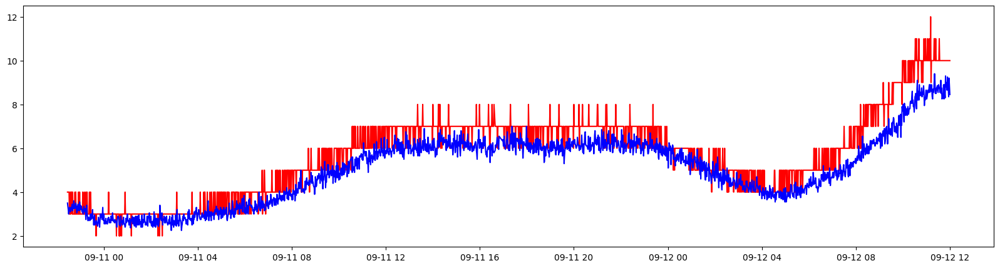

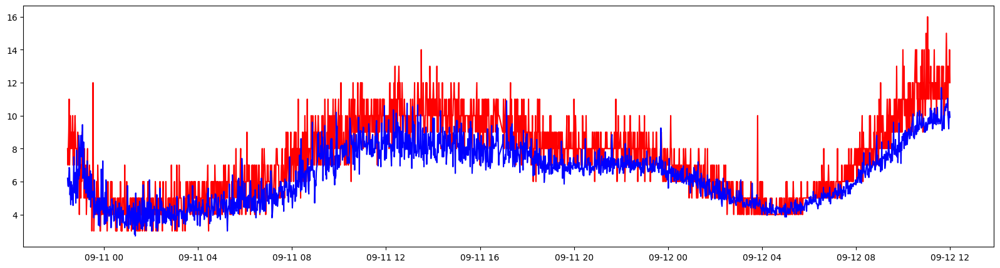

In [74]:
a9 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN9])
a9 = a9.dropna()
x = a9['created_at']
n1 = a9['PM2.5_ppb']
n2 = a9['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,n1,'r')
plt.plot(x,n2,'b')

x = a9['created_at']
n3 = a9['PM10_ppb']
n4 = a9['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,n3,'r')
plt.plot(x,n4,'b')

In [76]:
o = [a1, a2, a3, a4, a5, a6, a7, a8, a9]
y = [y2, z2, s2, t2, r2, v2, p2, m2, n2]
y_ = [y1, z1, s1, t1, r1, v1, p1, m1, n1]

npts=[None] * len(o)
lag = []
correlation = []
Node = ['PM2.5_BN1', 'PM2.5_BN2', 'PM2.5_BN3', 'PM2.5_BN4', 'PM2.5_BN5', 'PM2.5_BN6', 'PM2.5_BN7', 'PM2.5_BN8', 'PM2.5_BN9']

for i in range(0, len(o)):
    npts[i] = len(o[i])
    lags = np.arange(-npts[i] + 1, npts[i])
    lag.append(lags)
    ccov = np.correlate(y_[i] - y_[i].mean(), y[i] - y[i].mean(), mode='full')
    ccor = ccov / (npts[i] * y_[i].std() * y[i].std())
    correlation.append(ccor)
    maxlag = lags[np.argmax(ccor)]
    print('*************',Node[i],'***************')
    print("max correlation is at lag %d" % maxlag)
    print("max correlation is ", round(max(ccor),3))
    corr, _ = pearsonr(y[i], y_[i])
    print('Pearsons correlation: %.3f' % corr)
    MSE = mean_squared_error(y[i], y_[i])
    MAE = mean_absolute_error(y[i], y_[i])
    print("MSE PM2.5: ", MSE)
    print("MAE PM2.5: ", MAE)
    print("RMSE PM2.5: ", np.sqrt(mean_squared_error(y[i], y_[i])))

# o = [a1,a2,a3,a4]
# y = [y2,z2,c2,d2]
# y_ = [y1,z1,c1,d1]

# npts=[None] * len(o)
# lag = []
# correlation = []
# Node = ['PM2.5_BN1', 'PM2.5_BN2', 'PM2.5_BN3', 'PM2.5_BN4']

# for i in range(0, len(o)):
#     npts[i] = len(o[i])
#     lags = np.arange(-npts[i] + 1, npts[i])
#     lag.append(lags)
#     ccov = np.correlate(y_[i] - y_[i].mean(), y[i] - y[i].mean(), mode='full')
#     ccor = ccov / (npts[i] * y_[i].std() * y[i].std())
#     correlation.append(ccor)
#     maxlag = lags[np.argmax(ccor)]
#     print('*************',Node[i],'***************')
#     print("max correlation is at lag %d" % maxlag)
#     print("max correlation is ", round(max(ccor),3))
#     corr, _ = pearsonr(y[i], y_[i])
#     print('Pearsons correlation: %.3f' % corr)
#     MSE = mean_squared_error(y[i], y_[i])
#     MAE = mean_absolute_error(y[i], y_[i])
#     print("MSE PM2.5: ", MSE)
#     print("MAE PM2.5: ", MAE)
#     print("RMSE PM2.5: ", np.sqrt(mean_squared_error(y[i], y_[i])))

************* PM2.5_BN1 ***************
max correlation is at lag 0
max correlation is  0.964
Pearsons correlation: 0.965
MSE PM2.5:  0.4693838732708612
MAE PM2.5:  0.5560232039268184
RMSE PM2.5:  0.6851159560766784
************* PM2.5_BN2 ***************
max correlation is at lag 0
max correlation is  0.958
Pearsons correlation: 0.958
MSE PM2.5:  0.5199102695225346
MAE PM2.5:  0.5908817492190986
RMSE PM2.5:  0.7210480355167294
************* PM2.5_BN3 ***************
max correlation is at lag 0
max correlation is  0.963
Pearsons correlation: 0.964
MSE PM2.5:  1.6683898835978836
MAE PM2.5:  1.0614426807760142
RMSE PM2.5:  1.29166167536158
************* PM2.5_BN4 ***************
max correlation is at lag 0
max correlation is  0.956
Pearsons correlation: 0.957
MSE PM2.5:  0.8019521741071427
MAE PM2.5:  0.7312508928571428
RMSE PM2.5:  0.8955178245613779
************* PM2.5_BN5 ***************
max correlation is at lag 0
max correlation is  0.956
Pearsons correlation: 0.957
MSE PM2.5:  0.80

In [80]:
o = [a1, a2, a3, a4, a5, a6, a7, a8, a9]
y = [y3, z3, s3, t3, r3, v3, p3, m3, n3]
y_ = [y4, z4, s4, t4, r4, v4, p4, m4, n4]

npts=[None] * len(o)
lag = []
correlation = []
Node = ['PM10_BN1', 'PM10_BN2','PM10_BN3', 'PM10_BN4', 'PM2.5_BN5', 'PM2.5_BN6', 'PM2.5_BN7', 'PM2.5_BN8', 'PM2.5_BN9']

for i in range(0, len(o)):
    npts[i] = len(o[i])
    lags = np.arange(-npts[i] + 1, npts[i])
    lag.append(lags)
    ccov = np.correlate(y_[i] - y_[i].mean(), y[i] - y[i].mean(), mode='full')
    ccor = ccov / (npts[i] * y_[i].std() * y[i].std())
    correlation.append(ccor)
    maxlag = lags[np.argmax(ccor)]
    print('*************',Node[i],'***************')
    print("max correlation is at lag %d" % maxlag)
    print("max correlation is ", round(max(ccor),3))
    corr, _ = pearsonr(y[i], y_[i])
    print('Pearsons correlation: %.3f' % corr)
    MSE = mean_squared_error(y[i], y_[i])
    MAE = mean_absolute_error(y[i], y_[i])
    print("MSE PM2.5: ", MSE)
    print("MAE PM2.5: ", MAE)
    print("RMSE PM2.5: ", np.sqrt(mean_squared_error(y[i], y_[i])))

# o = [a1,a2,a3,a4]
# y = [y3,z3,c3,d3]
# y_ = [y4,z4,c4,d4]

# npts=[None] * len(o)
# lag = []
# correlation = []
# Node = ['PM10_BN1', 'PM10_BN2', 'PM10_BN3', 'PM10_BN4']

# for i in range(0, len(o)):
#     npts[i] = len(o[i])
#     lags = np.arange(-npts[i] + 1, npts[i])
#     lag.append(lags)
#     ccov = np.correlate(y_[i] - y_[i].mean(), y[i] - y[i].mean(), mode='full')
#     ccor = ccov / (npts[i] * y_[i].std() * y[i].std())
#     correlation.append(ccor)
#     maxlag = lags[np.argmax(ccor)]
#     print('*************',Node[i],'***************')
#     print("max correlation is at lag %d" % maxlag)
#     print("max correlation is ", round(max(ccor),3))
#     corr, _ = pearsonr(y[i], y_[i])
#     print('Pearsons correlation: %.3f' % corr)
#     MSE = mean_squared_error(y[i], y_[i])
#     MAE = mean_absolute_error(y[i], y_[i])
#     print("MSE PM2.5: ", MSE)
#     print("MAE PM2.5: ", MAE)
#     print("RMSE PM2.5: ", np.sqrt(mean_squared_error(y[i], y_[i])))

************* PM10_BN1 ***************
max correlation is at lag 0
max correlation is  0.871
Pearsons correlation: 0.872
MSE PM2.5:  8.455159182061578
MAE PM2.5:  2.683512271307452
RMSE PM2.5:  2.907775641630829
************* PM10_BN2 ***************
max correlation is at lag 1
max correlation is  0.862
Pearsons correlation: 0.860
MSE PM2.5:  13.638134455600177
MAE PM2.5:  3.483236501561803
RMSE PM2.5:  3.6929844916544368
************* PM10_BN3 ***************
max correlation is at lag 3
max correlation is  0.83
Pearsons correlation: 0.829
MSE PM2.5:  2.444082855379189
MAE PM2.5:  1.1957889476778365
RMSE PM2.5:  1.5633562790928974
************* PM10_BN4 ***************
max correlation is at lag 7
max correlation is  0.843
Pearsons correlation: 0.839
MSE PM2.5:  2.7325904723214287
MAE PM2.5:  1.2682803571428574
RMSE PM2.5:  1.6530548908978882
************* PM2.5_BN5 ***************
max correlation is at lag 7
max correlation is  0.843
Pearsons correlation: 0.839
MSE PM2.5:  2.7325904723

# Node 1 Coefficients


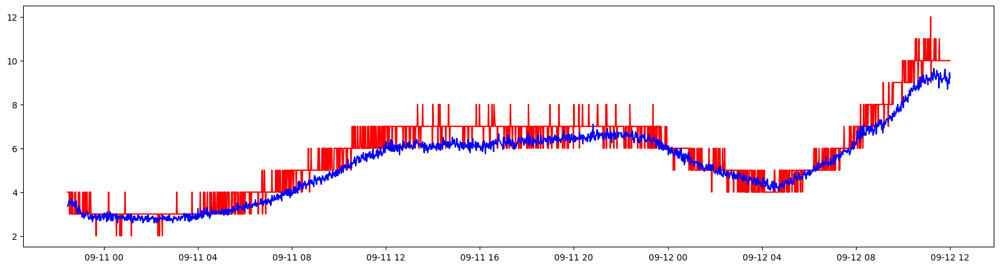

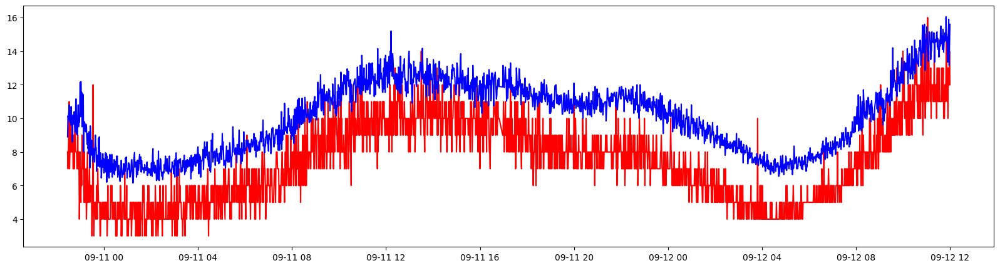

In [81]:
a1 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN1])
a1 = a1.dropna()
a1 = a1[a1['PM2.5'] <= 999]
x = a1['created_at']
y1 = a1['PM2.5_ppb']
y2 = a1['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,y1,'r')
plt.plot(x,y2,'b')

x = a1['created_at']
y3 = a1['PM10_ppb']
y4 = a1['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,y3,'r')
plt.plot(x,y4,'b')

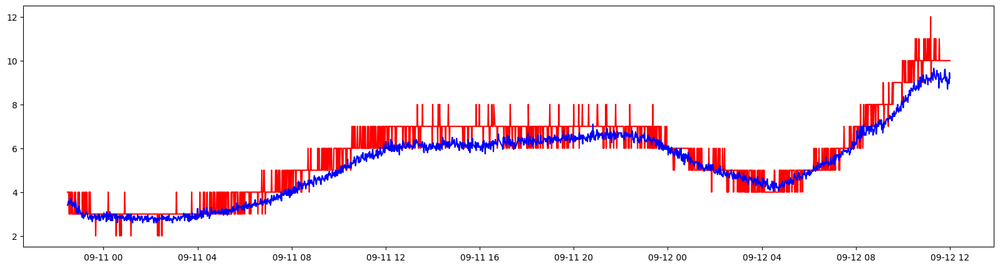

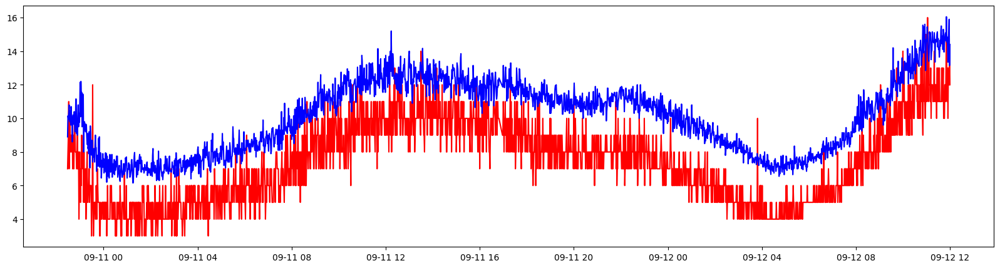

In [82]:
a1['PM2.5_shift'] = a1['PM2.5'].shift(0)
a1['PM10_shift'] = a1['PM10'].shift(1)

a1 = a1.dropna()
x = a1['created_at']
y_1 = a1['PM2.5_ppb']
y_2 = a1['PM2.5_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,y_1,'r')
plt.plot(x,y_2,'b')

x = a1['created_at']
y_3 = a1['PM10_ppb']
y_4 = a1['PM10_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,y_3,'r')
plt.plot(x,y_4,'b')

In [83]:
npts = len(a1)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(y_1 - y_1.mean(), y_2 - y_2.mean(), mode='full')
ccor = ccov / (npts * y_1.std() * y_2.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('*************',Node[i],'***************')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(y_2, y_1)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(y_2, y_1)
MAE = mean_absolute_error(y_2, y_1)
print("MSE PM2.5: ", MSE)
print("MAE PM2.5: ", MAE)
print("RMSE PM2.5: ", np.sqrt(mean_squared_error(y_2, y_1)))

npts = len(a1)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(y_3 - y_3.mean(), y_4 - y_4.mean(), mode='full')
ccor = ccov / (npts * y_3.std() * y_4.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('*************',Node[i],'***************')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(y_4, y_3)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(y_4, y_3)
MAE = mean_absolute_error(y_4, y_3)
print("MSE PM10: ", MSE)
print("MAE PM10: ", MAE)
print("RMSE PM10: ", np.sqrt(mean_squared_error(y_4, y_3)))

max correlation is at lag 0
max correlation is  0.964
Pearsons correlation: 0.965
MSE PM2.5:  0.4694048035714285
MAE PM2.5:  0.5559812500000001
RMSE PM2.5:  0.6851312309123183
max correlation is at lag -1
max correlation is  0.87
Pearsons correlation: 0.866
MSE PM10:  8.504755235267858
MAE PM10:  2.687998660714286
RMSE PM10:  2.9162913495170297


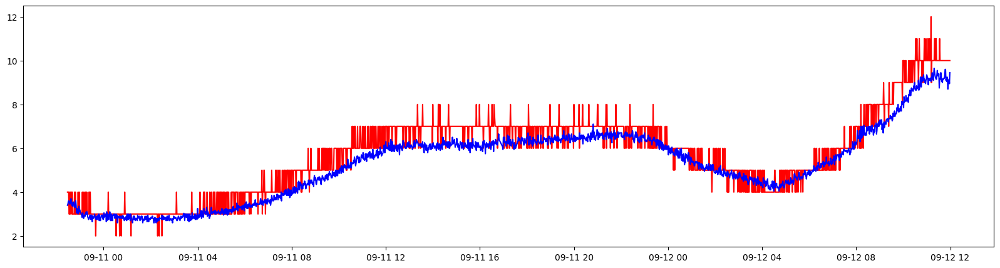

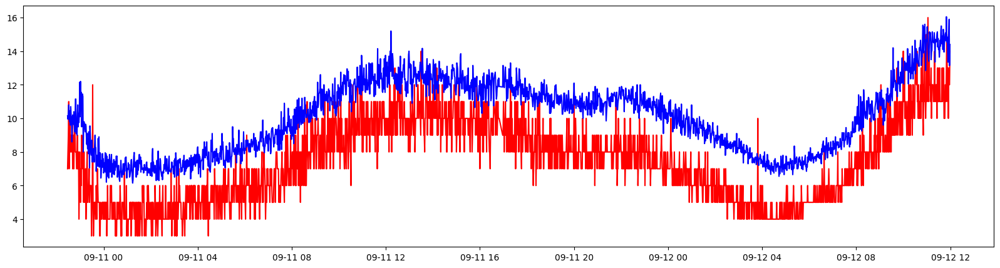

In [84]:
a1['PM2.5_shift'] = a1['PM2.5_shift'].shift(0)
a1['PM10_shift'] = a1['PM10_shift'].shift(-1)

a1 = a1.dropna()
x = a1['created_at']
y_1 = a1['PM2.5_ppb']
y_2 = a1['PM2.5_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,y_1,'r')
plt.plot(x,y_2,'b')

x = a1['created_at']
y_3 = a1['PM10_ppb']
y_4 = a1['PM10_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,y_3,'r')
plt.plot(x,y_4,'b')

In [85]:
npts = len(a1)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(y_1 - y_1.mean(), y_2 - y_2.mean(), mode='full')
ccor = ccov / (npts * y_1.std() * y_2.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('*************',Node[i],'***************')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(y_2, y_1)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(y_2, y_1)
MAE = mean_absolute_error(y_2, y_1)
print("MSE PM2.5: ", MSE)
print("MAE PM2.5: ", MAE)
print("RMSE PM2.5: ", np.sqrt(mean_squared_error(y_2, y_1)))

npts = len(a1)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(y_3 - y_3.mean(), y_4 - y_4.mean(), mode='full')
ccor = ccov / (npts * y_3.std() * y_4.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('*************',Node[i],'***************')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(y_4, y_3)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(y_4, y_3)
MAE = mean_absolute_error(y_4, y_3)
print("MSE PM10: ", MSE)
print("MAE PM10: ", MAE)
print("RMSE PM10: ", np.sqrt(mean_squared_error(y_4, y_3)))

max correlation is at lag 0
max correlation is  0.964
Pearsons correlation: 0.964
MSE PM2.5:  0.46932861098704776
MAE PM2.5:  0.5558722644037517
RMSE PM2.5:  0.685075624283223
max correlation is at lag 0
max correlation is  0.871
Pearsons correlation: 0.872
MSE PM10:  8.456561736042877
MAE PM10:  2.683899508709245
RMSE PM10:  2.908016804635571


In [86]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LinearRegression
from sklearn import metrics
from scipy.stats import spearmanr, pearsonr
X = a1['PM2.5_shift']
y = a1['PM2.5_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')

Coefficients:  [1.11189465]
Intercept:  -0.15577177270931664
R2  0.9344875419583049
MAE of simple linear regression of  0.3760706273324329
MSE of simple linear regression 0.23637416078225534
RMSE of simple linear regression 0.4861832584347751
Test data Spearman correlation of simple linear regression: 0.948


In [87]:

X = a1['PM10_shift']
y = a1['PM10_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')

Coefficients:  [0.97416302]
Intercept:  -2.4058939389444767
R2  0.7389329546505246
MAE of simple linear regression of  0.9819396932533948
MSE of simple linear regression 1.51911716949529
RMSE of simple linear regression 1.2325247135434203
Test data Spearman correlation of simple linear regression: 0.862


# Node 2 Coefficients

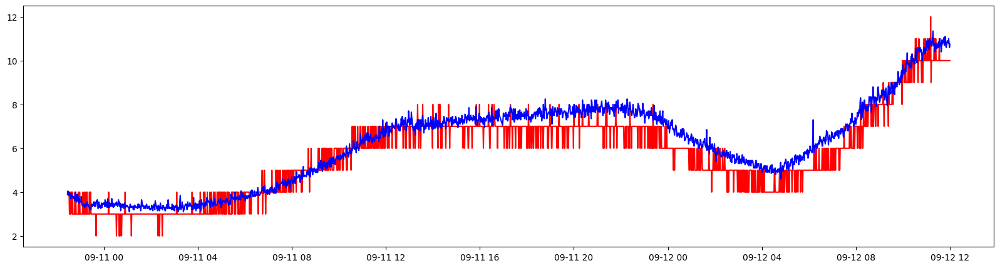

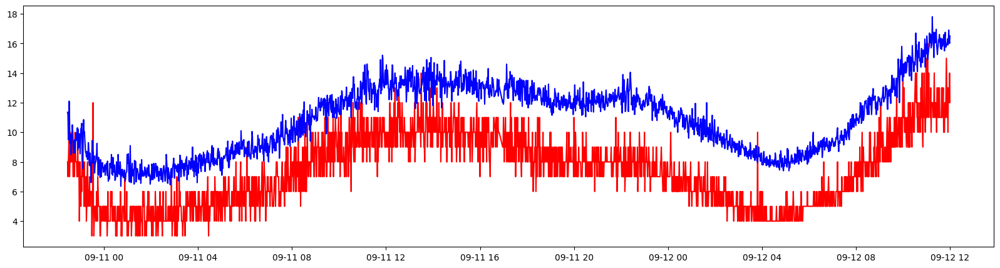

In [88]:
a2 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN2])
a2 = a2.dropna()
a2 = a2[a2['PM2.5'] <= 999]
x = a2['created_at']
z1 = a2['PM2.5_ppb']
z2 = a2['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z1,'r')
plt.plot(x,z2,'b')

x = a2['created_at']
z3 = a2['PM10_ppb']
z4 = a2['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z3,'r')
plt.plot(x,z4,'b')

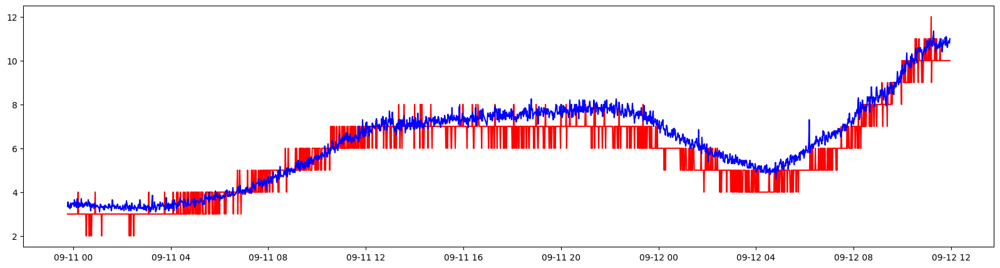

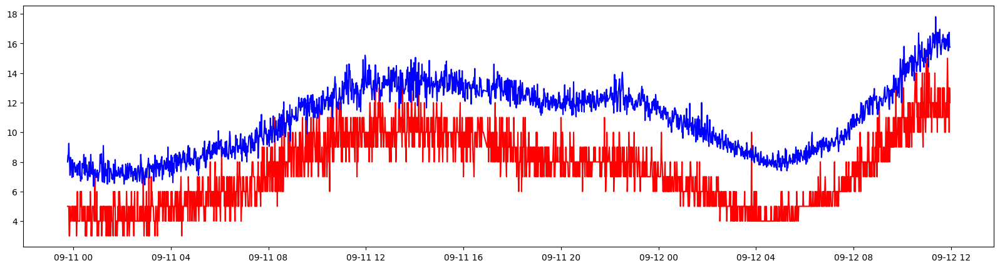

In [146]:
a2['PM2.5_shift'] = a2['PM2.5'].shift(0)
a2['PM10_shift'] = a2['PM10'].shift(7)

a2 = a2.dropna()
x = a2['created_at']
z_1 = a2['PM2.5_ppb']
z_2 = a2['PM2.5_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_1,'r')
plt.plot(x,z_2,'b')

x = a2['created_at']
z_3 = a2['PM10_ppb']
z_4 = a2['PM10_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_3,'r')
plt.plot(x,z_4,'b')

In [147]:
npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_1 - z_1.mean(), z_2 - z_2.mean(), mode='full')
ccor = ccov / (npts * z_1.std() * z_2.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('*************',Node[i],'***************')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_2, z_1)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_2, z_1)
MAE = mean_absolute_error(z_2, z_1)
print("MSE PM2.5: ", MSE)
print("MAE PM2.5: ", MAE)
print("RMSE PM2.5: ", np.sqrt(mean_squared_error(z_2, z_1)))

npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_3 - z_3.mean(), z_4 - z_4.mean(), mode='full')
ccor = ccov / (npts * z_3.std() * z_4.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('*************',Node[i],'***************')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_4, z_3)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_4, z_3)
MAE = mean_absolute_error(z_4, z_3)
print("MSE PM10: ", MSE)
print("MAE PM10: ", MAE)
print("RMSE PM10: ", np.sqrt(mean_squared_error(z_4, z_3)))

max correlation is at lag 0
max correlation is  0.956
Pearsons correlation: 0.956
MSE PM2.5:  0.527466662806855
MAE PM2.5:  0.5939708198239926
RMSE PM2.5:  0.7262690016838492
max correlation is at lag 0
max correlation is  0.866
Pearsons correlation: 0.866
MSE PM10:  13.687348465493285
MAE PM10:  3.4933612783696155
RMSE PM10:  3.699641667174442


In [148]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
X = a2['PM2.5_shift']
y = a2['PM2.5_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')


Coefficients:  [0.93065384]
Intercept:  -0.042452832951062724
R2  0.9167328667971646
MAE of simple linear regression of  0.4070247392899878
MSE of simple linear regression 0.29492540036118947
RMSE of simple linear regression 0.5430703456838621
Test data Spearman correlation of simple linear regression: 0.939


In [95]:

X = a2['PM10_shift']
y = a2['PM10_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')


Coefficients:  [0.87536591]
Intercept:  -2.120042654595153
R2  0.729496873733116
MAE of simple linear regression of  0.9895997482953378
MSE of simple linear regression 1.5365952688899234
RMSE of simple linear regression 1.2395948002835133
Test data Spearman correlation of simple linear regression: 0.856


NODE-3


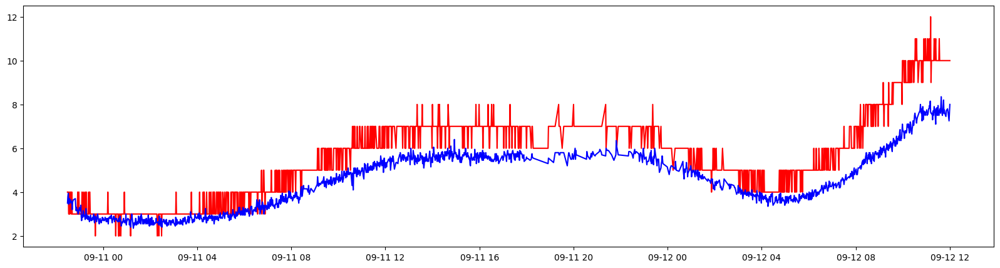

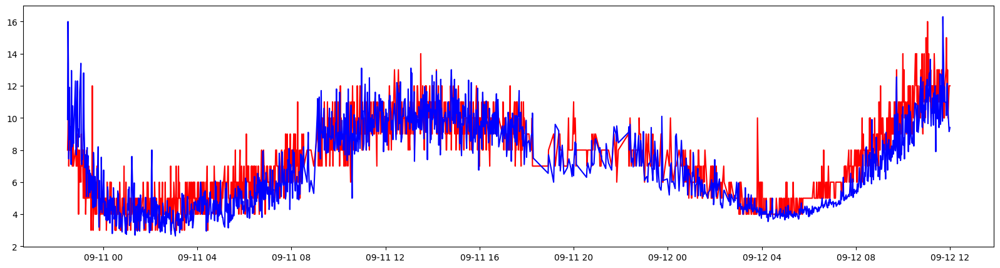

In [96]:
a3 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN3])
a3 = a3.dropna()
x = a3['created_at']
s1 = a3['PM2.5_ppb']
s2 = a3['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,s1,'r')
plt.plot(x,s2,'b')

x = a3['created_at']
s3 = a3['PM10_ppb']
s4 = a3['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,s3,'r')
plt.plot(x,s4,'b')

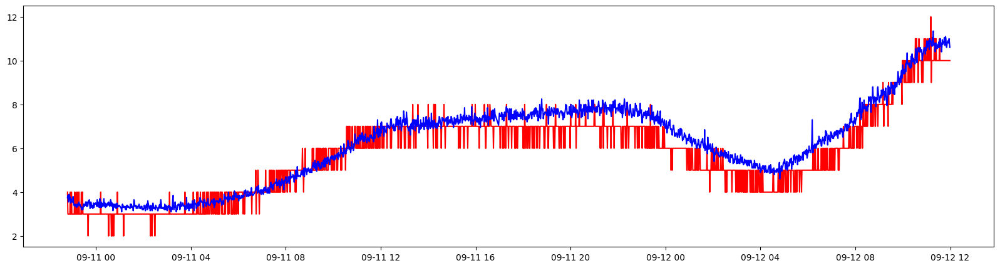

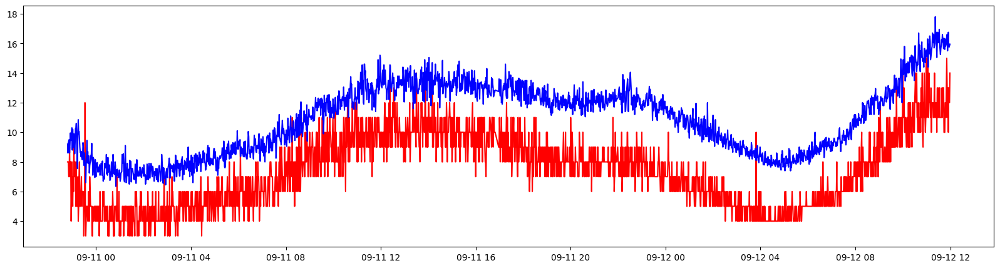

In [97]:
a2['PM2.5_shift'] = a2['PM2.5'].shift(0)
a2['PM10_shift'] = a2['PM10'].shift(7)

a2 = a2.dropna()
x = a2['created_at']
z_1 = a2['PM2.5_ppb']
z_2 = a2['PM2.5_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_1,'r')
plt.plot(x,z_2,'b')

x = a2['created_at']
z_3 = a2['PM10_ppb']
z_4 = a2['PM10_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_3,'r')
plt.plot(x,z_4,'b')

In [98]:
npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_1 - z_1.mean(), z_2 - z_2.mean(), mode='full')
ccor = ccov / (npts * z_1.std() * z_2.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('*************',Node[i],'***************')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_2, z_1)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_2, z_1)
MAE = mean_absolute_error(z_2, z_1)
print("MSE PM2.5: ", MSE)
print("MAE PM2.5: ", MAE)
print("RMSE PM2.5: ", np.sqrt(mean_squared_error(z_2, z_1)))

npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_3 - z_3.mean(), z_4 - z_4.mean(), mode='full')
ccor = ccov / (npts * z_3.std() * z_4.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('*************',Node[i],'***************')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_4, z_3)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_4, z_3)
MAE = mean_absolute_error(z_4, z_3)
print("MSE PM10: ", MSE)
print("MAE PM10: ", MAE)
print("RMSE PM10: ", np.sqrt(mean_squared_error(z_4, z_3)))

max correlation is at lag 0
max correlation is  0.958
Pearsons correlation: 0.958
MSE PM2.5:  0.5216725615141956
MAE PM2.5:  0.5920306444344299
RMSE PM2.5:  0.722269036795982
max correlation is at lag 0
max correlation is  0.862
Pearsons correlation: 0.862
MSE PM10:  13.595132859396125
MAE PM10:  3.477850833708878
RMSE PM10:  3.6871578294665017


In [99]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
X = a2['PM2.5_shift']
y = a2['PM2.5_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')


Coefficients:  [0.93129538]
Intercept:  -0.04647802692328007
R2  0.9196822305870442
MAE of simple linear regression of  0.39553475344652894
MSE of simple linear regression 0.2756510930893512
RMSE of simple linear regression 0.5250248499731714
Test data Spearman correlation of simple linear regression: 0.938


In [100]:

X = a2['PM10_shift']
y = a2['PM10_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')


Coefficients:  [0.86952897]
Intercept:  -2.0774978920598652
R2  0.7472417243764247
MAE of simple linear regression of  0.9683168064731877
MSE of simple linear regression 1.413509524995365
RMSE of simple linear regression 1.1889110668991878
Test data Spearman correlation of simple linear regression: 0.863


NODE-4

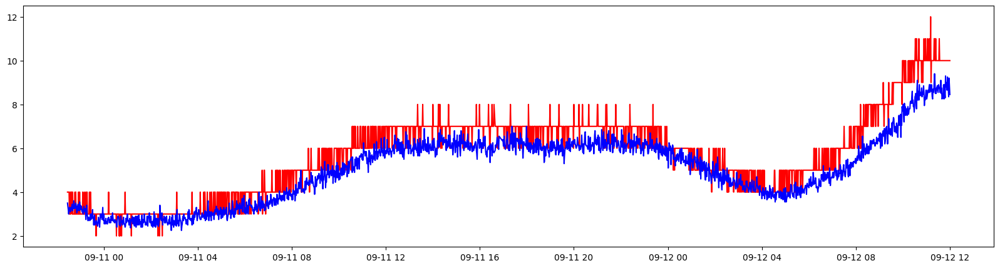

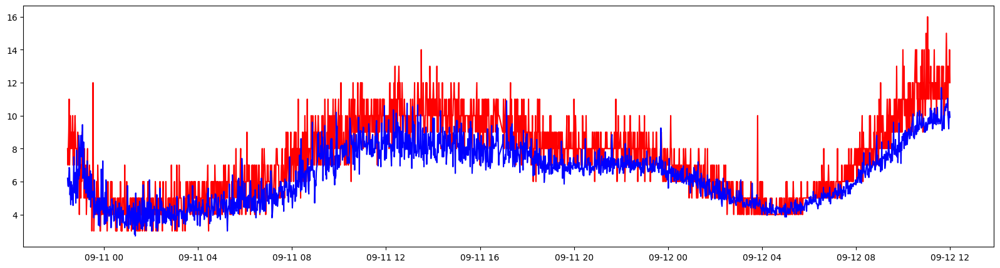

In [101]:
a4 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN4])
a4 = a4.dropna()
x = a4['created_at']
t1 = a4['PM2.5_ppb']
t2 = a4['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,t1,'r')
plt.plot(x,t2,'b')

x = a4['created_at']
t3 = a4['PM10_ppb']
t4 = a4['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,t3,'r')
plt.plot(x,t4,'b')

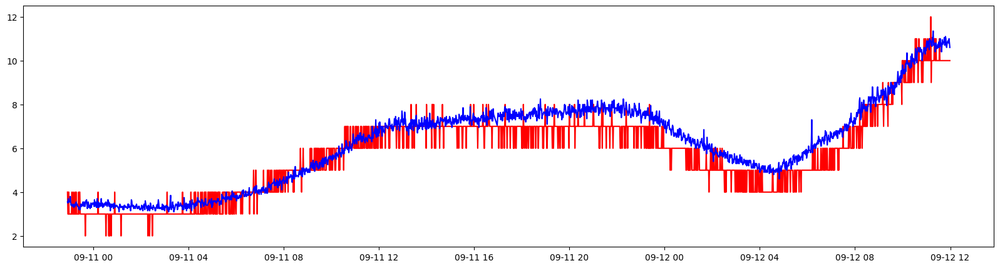

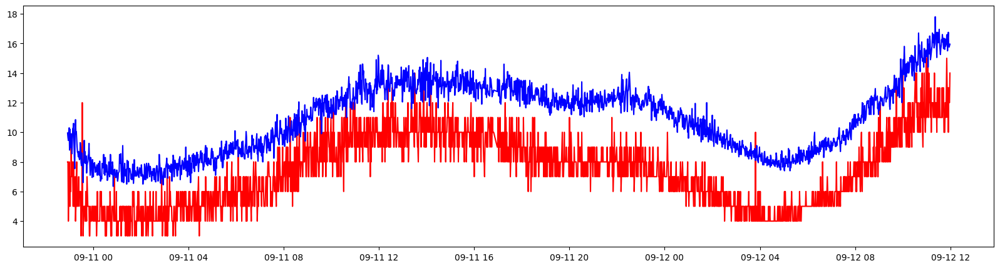

In [102]:
a2['PM2.5_shift'] = a2['PM2.5'].shift(0)
a2['PM10_shift'] = a2['PM10'].shift(7)

a2 = a2.dropna()
x = a2['created_at']
z_1 = a2['PM2.5_ppb']
z_2 = a2['PM2.5_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_1,'r')
plt.plot(x,z_2,'b')

x = a2['created_at']
z_3 = a2['PM10_ppb']
z_4 = a2['PM10_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_3,'r')
plt.plot(x,z_4,'b')

In [103]:
npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_1 - z_1.mean(), z_2 - z_2.mean(), mode='full')
ccor = ccov / (npts * z_1.std() * z_2.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('',Node[i],'')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_2, z_1)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_2, z_1)
MAE = mean_absolute_error(z_2, z_1)
print("MSE PM2.5: ", MSE)
print("MAE PM2.5: ", MAE)
print("RMSE PM2.5: ", np.sqrt(mean_squared_error(z_2, z_1)))

npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_3 - z_3.mean(), z_4 - z_4.mean(), mode='full')
ccor = ccov / (npts * z_3.std() * z_4.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('',Node[i],'')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_4, z_3)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_4, z_3)
MAE = mean_absolute_error(z_4, z_3)
print("MSE PM10: ", MSE)
print("MAE PM10: ", MAE)
print("RMSE PM10: ", np.sqrt(mean_squared_error(z_4, z_3)))

max correlation is at lag 0
max correlation is  0.957
Pearsons correlation: 0.958
MSE PM2.5:  0.5217920045207958
MAE PM2.5:  0.5918019891500903
RMSE PM2.5:  0.7223517180160893
max correlation is at lag 0
max correlation is  0.863
Pearsons correlation: 0.863
MSE PM10:  13.628887800632912
MAE PM10:  3.4840646473779384
RMSE PM10:  3.691732357665289


In [104]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
X = a2['PM2.5_shift']
y = a2['PM2.5_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')

Coefficients:  [0.93084436]
Intercept:  -0.045761234323306255
R2  0.9154871905941243
MAE of simple linear regression of  0.4193931749687009
MSE of simple linear regression 0.30082837690163255
RMSE of simple linear regression 0.5484782374002022
Test data Spearman correlation of simple linear regression: 0.945


In [105]:
X = a2['PM10_shift']
y = a2['PM10_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')

Coefficients:  [0.87678714]
Intercept:  -2.1691424052292527
R2  0.7402483133749185
MAE of simple linear regression of  0.9632004989324571
MSE of simple linear regression 1.5204227178563483
RMSE of simple linear regression 1.2330542234047732
Test data Spearman correlation of simple linear regression: 0.866


NODE-5

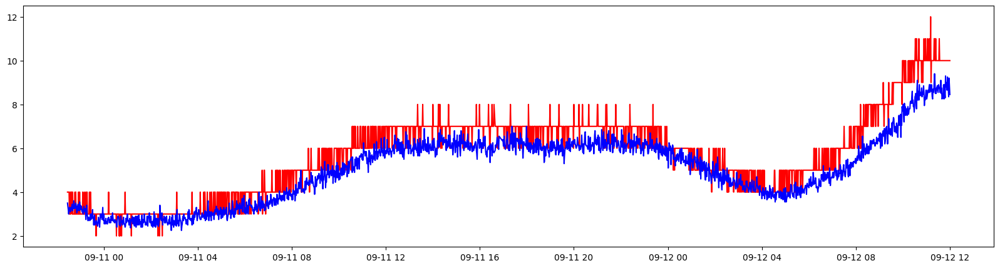

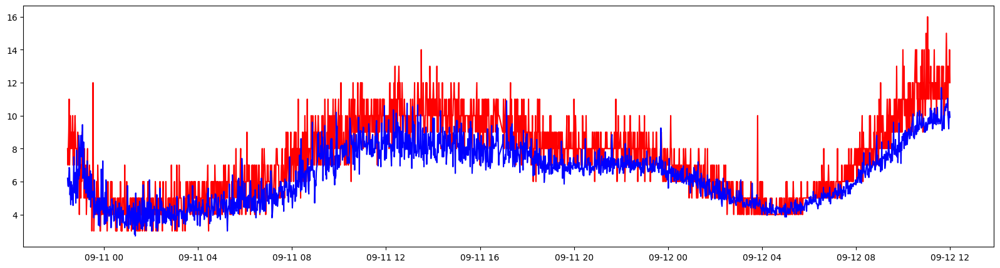

In [106]:
a5 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN5])
a5 = a5.dropna()
x = a5['created_at']
r1 = a5['PM2.5_ppb']
r2 = a5['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,r1,'r')
plt.plot(x,r2,'b')

x = a5['created_at']
r3 = a5['PM10_ppb']
r4 = a5['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,r3,'r')
plt.plot(x,r4,'b')

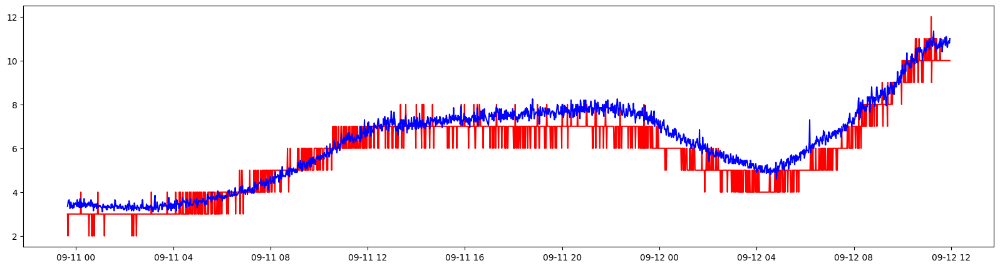

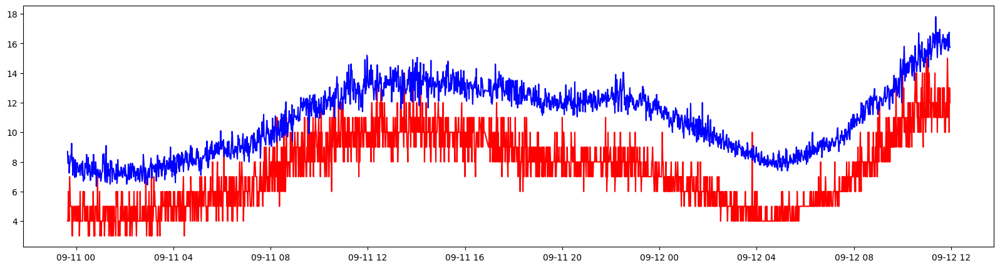

In [141]:
a2['PM2.5_shift'] = a2['PM2.5'].shift(0)
a2['PM10_shift'] = a2['PM10'].shift(7)

a2 = a2.dropna()
x = a2['created_at']
z_1 = a2['PM2.5_ppb']
z_2 = a2['PM2.5_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_1,'r')
plt.plot(x,z_2,'b')

x = a2['created_at']
z_3 = a2['PM10_ppb']
z_4 = a2['PM10_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_3,'r')
plt.plot(x,z_4,'b')

In [142]:
npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_1 - z_1.mean(), z_2 - z_2.mean(), mode='full')
ccor = ccov / (npts * z_1.std() * z_2.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('',Node[i],'')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_2, z_1)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_2, z_1)
MAE = mean_absolute_error(z_2, z_1)
print("MSE PM2.5: ", MSE)
print("MAE PM2.5: ", MAE)
print("RMSE PM2.5: ", np.sqrt(mean_squared_error(z_2, z_1)))

npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_3 - z_3.mean(), z_4 - z_4.mean(), mode='full')
ccor = ccov / (npts * z_3.std() * z_4.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('',Node[i],'')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_4, z_3)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_4, z_3)
MAE = mean_absolute_error(z_4, z_3)
print("MSE PM10: ", MSE)
print("MAE PM10: ", MAE)
print("RMSE PM10: ", np.sqrt(mean_squared_error(z_4, z_3)))

max correlation is at lag 0
max correlation is  0.956
Pearsons correlation: 0.957
MSE PM2.5:  0.5274390697137581
MAE PM2.5:  0.5940595567867035
RMSE PM2.5:  0.7262500049664428
max correlation is at lag 0
max correlation is  0.866
Pearsons correlation: 0.866
MSE PM10:  13.674410358725764
MAE PM10:  3.4912820867959375
RMSE PM10:  3.6978926916185335


In [144]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
X = a2['PM2.5_shift']
y = a2['PM2.5_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')

Coefficients:  [0.93077389]
Intercept:  -0.034799102852463015
R2  0.916653012792943
MAE of simple linear regression of  0.40270535202984337
MSE of simple linear regression 0.2802798871917323
RMSE of simple linear regression 0.5294146646927457
Test data Spearman correlation of simple linear regression: 0.937


In [145]:
X = a2['PM10_shift']
y = a2['PM10_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')

Coefficients:  [0.89324961]
Intercept:  -2.3226766645912846
R2  0.7164451718170108
MAE of simple linear regression of  0.9651887710613837
MSE of simple linear regression 1.4793232243009888
RMSE of simple linear regression 1.2162743211549722
Test data Spearman correlation of simple linear regression: 0.849


NODE-6

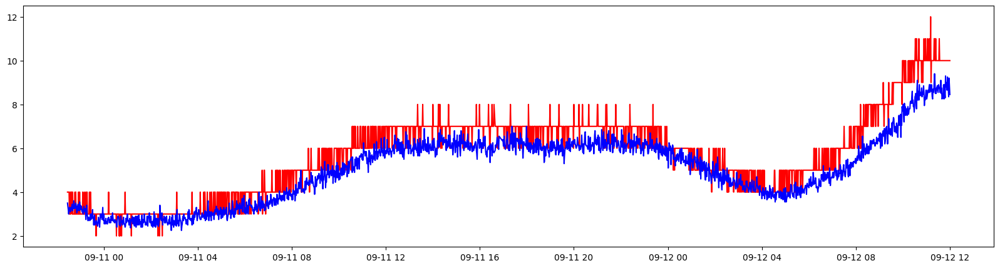

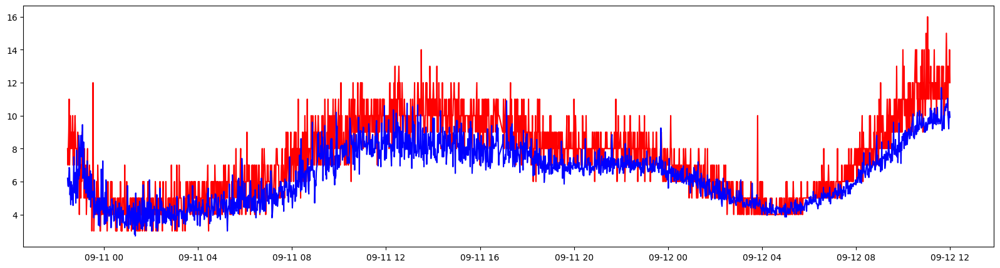

In [113]:
a6 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN6])
a6 = a6.dropna()
x = a6['created_at']
v1 = a6['PM2.5_ppb']
v2 = a6['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,v1,'r')
plt.plot(x,v2,'b')

x = a6['created_at']
v3 = a6['PM10_ppb']
v4 = a6['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,v3,'r')
plt.plot(x,v4,'b')

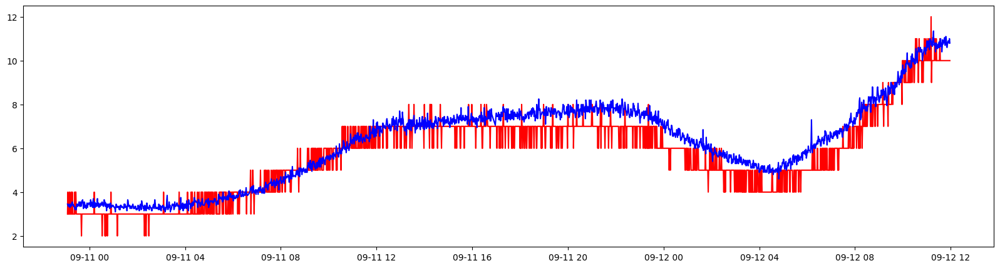

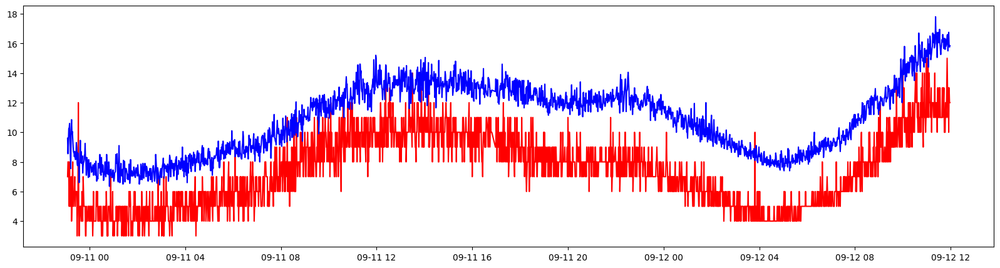

In [114]:
a2['PM2.5_shift'] = a2['PM2.5'].shift(0)
a2['PM10_shift'] = a2['PM10'].shift(7)

a2 = a2.dropna()
x = a2['created_at']
z_1 = a2['PM2.5_ppb']
z_2 = a2['PM2.5_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_1,'r')
plt.plot(x,z_2,'b')

x = a2['created_at']
z_3 = a2['PM10_ppb']
z_4 = a2['PM10_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_3,'r')
plt.plot(x,z_4,'b')

In [115]:
npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_1 - z_1.mean(), z_2 - z_2.mean(), mode='full')
ccor = ccov / (npts * z_1.std() * z_2.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('',Node[i],'')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_2, z_1)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_2, z_1)
MAE = mean_absolute_error(z_2, z_1)
print("MSE PM2.5: ", MSE)
print("MAE PM2.5: ", MAE)
print("RMSE PM2.5: ", np.sqrt(mean_squared_error(z_2, z_1)))

npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_3 - z_3.mean(), z_4 - z_4.mean(), mode='full')
ccor = ccov / (npts * z_3.std() * z_4.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('',Node[i],'')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_4, z_3)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_4, z_3)
MAE = mean_absolute_error(z_4, z_3)
print("MSE PM10: ", MSE)
print("MAE PM10: ", MAE)
print("RMSE PM10: ", np.sqrt(mean_squared_error(z_4, z_3)))

max correlation is at lag 0
max correlation is  0.957
Pearsons correlation: 0.958
MSE PM2.5:  0.5228027778282599
MAE PM2.5:  0.5919881871876419
RMSE PM2.5:  0.7230510202110636
max correlation is at lag 0
max correlation is  0.863
Pearsons correlation: 0.864
MSE PM10:  13.645916544752385
MAE PM10:  3.48714266242617
RMSE PM10:  3.69403797283574


In [116]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
X = a2['PM2.5_shift']
y = a2['PM2.5_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')

Coefficients:  [0.93128634]
Intercept:  -0.043879447982766884
R2  0.9220602454597424
MAE of simple linear regression of  0.3794555739479715
MSE of simple linear regression 0.2599947515491407
RMSE of simple linear regression 0.5098968048038158
Test data Spearman correlation of simple linear regression: 0.945


In [117]:
X = a2['PM10_shift']
y = a2['PM10_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')

Coefficients:  [0.88188346]
Intercept:  -2.195154621113316
R2  0.7083383654106443
MAE of simple linear regression of  0.9894329028282066
MSE of simple linear regression 1.6309812307004088
RMSE of simple linear regression 1.27709875526539
Test data Spearman correlation of simple linear regression: 0.848


NODE-7

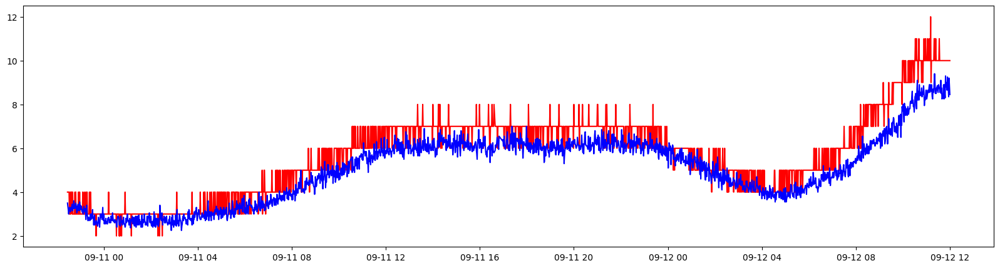

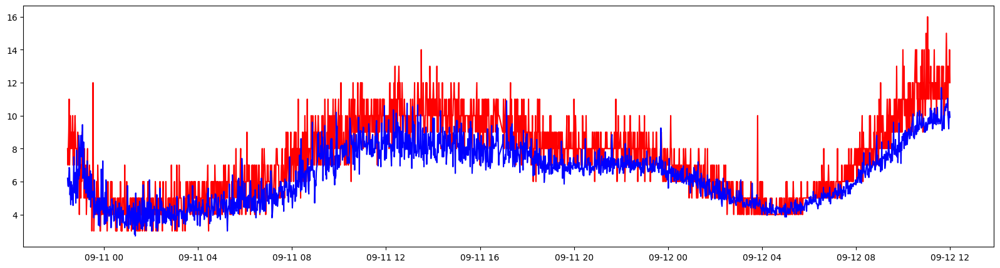

In [118]:
a7 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN7])
a7 = a7.dropna()
x = a7['created_at']
p1 = a7['PM2.5_ppb']
p2 = a7['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,p1,'r')
plt.plot(x,p2,'b')

x = a7['created_at']
p3 = a7['PM10_ppb']
p4 = a7['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,p3,'r')
plt.plot(x,p4,'b')

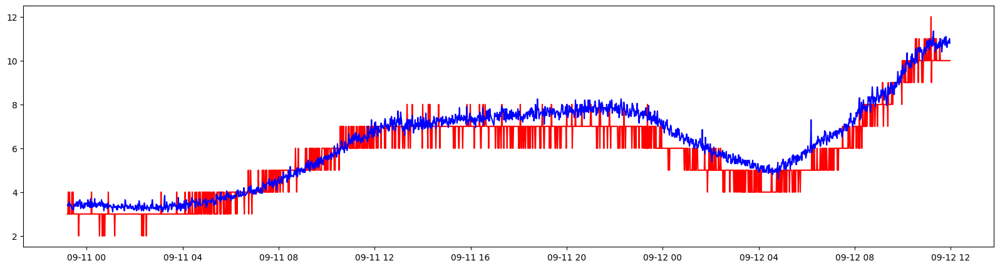

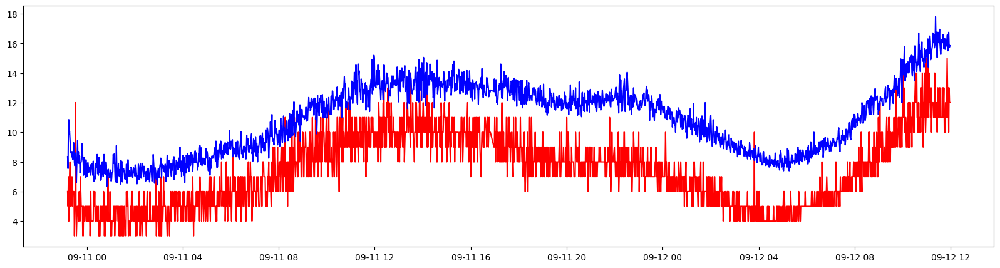

In [119]:
a2['PM2.5_shift'] = a2['PM2.5'].shift(0)
a2['PM10_shift'] = a2['PM10'].shift(7)

a2 = a2.dropna()
x = a2['created_at']
z_1 = a2['PM2.5_ppb']
z_2 = a2['PM2.5_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_1,'r')
plt.plot(x,z_2,'b')

x = a2['created_at']
z_3 = a2['PM10_ppb']
z_4 = a2['PM10_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_3,'r')
plt.plot(x,z_4,'b')

In [120]:
npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_1 - z_1.mean(), z_2 - z_2.mean(), mode='full')
ccor = ccov / (npts * z_1.std() * z_2.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('',Node[i],'')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_2, z_1)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_2, z_1)
MAE = mean_absolute_error(z_2, z_1)
print("MSE PM2.5: ", MSE)
print("MAE PM2.5: ", MAE)
print("RMSE PM2.5: ", np.sqrt(mean_squared_error(z_2, z_1)))

npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_3 - z_3.mean(), z_4 - z_4.mean(), mode='full')
ccor = ccov / (npts * z_3.std() * z_4.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('',Node[i],'')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_4, z_3)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_4, z_3)
MAE = mean_absolute_error(z_4, z_3)
print("MSE PM10: ", MSE)
print("MAE PM10: ", MAE)
print("RMSE PM10: ", np.sqrt(mean_squared_error(z_4, z_3)))

max correlation is at lag 0
max correlation is  0.957
Pearsons correlation: 0.957
MSE PM2.5:  0.5237882470373746
MAE PM2.5:  0.5924412032816773
RMSE PM2.5:  0.7237321652637628
max correlation is at lag 0
max correlation is  0.864
Pearsons correlation: 0.864
MSE PM10:  13.65618268687329
MAE PM10:  3.4891754785779394
RMSE PM10:  3.695427267160496


In [121]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
X = a2['PM2.5_shift']
y = a2['PM2.5_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')

Coefficients:  [0.92966884]
Intercept:  -0.025512297304354448
R2  0.9210480588377208
MAE of simple linear regression of  0.4111116300820886
MSE of simple linear regression 0.2980223672424034
RMSE of simple linear regression 0.5459142489827531
Test data Spearman correlation of simple linear regression: 0.944


In [122]:
X = a2['PM10_shift']
y = a2['PM10_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')

Coefficients:  [0.88192438]
Intercept:  -2.1914641608585033
R2  0.7439628729209085
MAE of simple linear regression of  0.9935213643477879
MSE of simple linear regression 1.4762073973681475
RMSE of simple linear regression 1.2149927560969849
Test data Spearman correlation of simple linear regression: 0.87


NODE-8

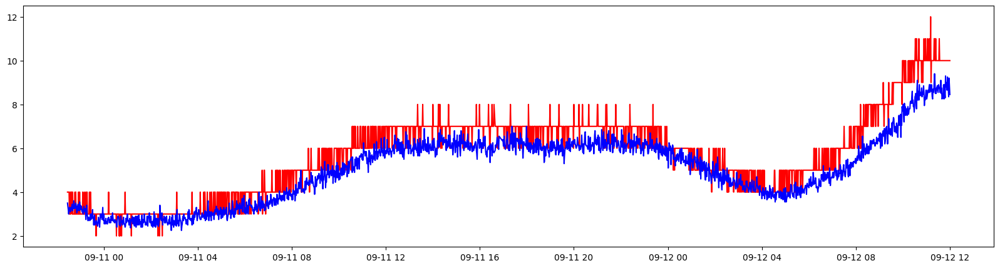

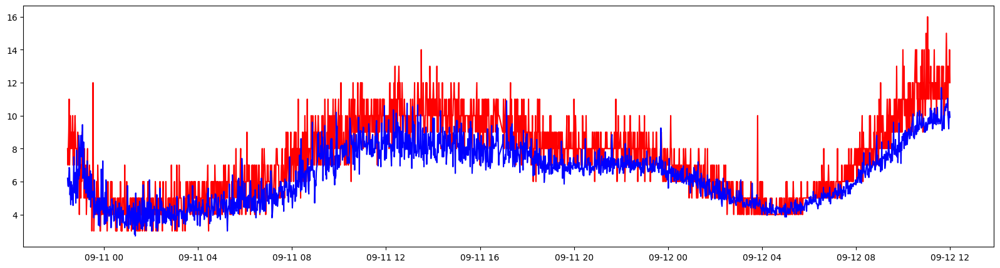

In [123]:
a8 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN8])
a8 = a8.dropna()
x = a8['created_at']
m1 = a8['PM2.5_ppb']
m2 = a8['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,m1,'r')
plt.plot(x,m2,'b')

x = a8['created_at']
m3 = a8['PM10_ppb']
m4 = a8['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,m3,'r')
plt.plot(x,m4,'b')

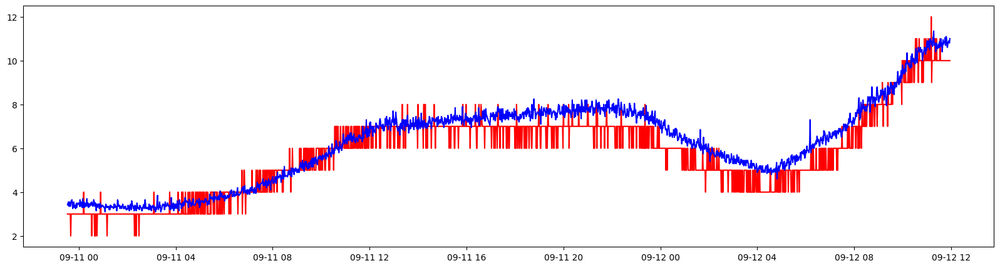

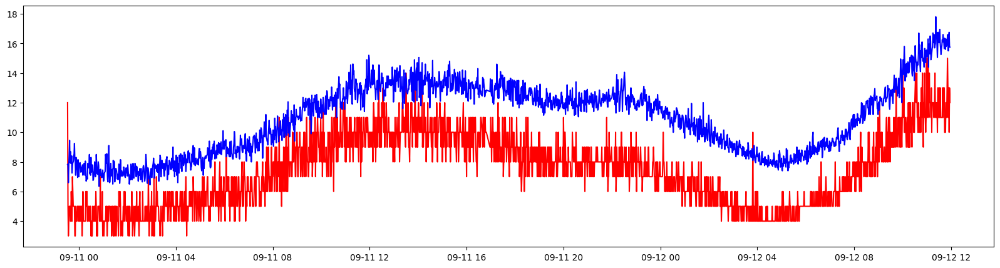

In [135]:
a2['PM2.5_shift'] = a2['PM2.5'].shift(0)
a2['PM10_shift'] = a2['PM10'].shift(7)

a2 = a2.dropna()
x = a2['created_at']
z_1 = a2['PM2.5_ppb']
z_2 = a2['PM2.5_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_1,'r')
plt.plot(x,z_2,'b')

x = a2['created_at']
z_3 = a2['PM10_ppb']
z_4 = a2['PM10_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_3,'r')
plt.plot(x,z_4,'b')

In [136]:
npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_1 - z_1.mean(), z_2 - z_2.mean(), mode='full')
ccor = ccov / (npts * z_1.std() * z_2.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('',Node[i],'')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_2, z_1)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_2, z_1)
MAE = mean_absolute_error(z_2, z_1)
print("MSE PM2.5: ", MSE)
print("MAE PM2.5: ", MAE)
print("RMSE PM2.5: ", np.sqrt(mean_squared_error(z_2, z_1)))

npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_3 - z_3.mean(), z_4 - z_4.mean(), mode='full')
ccor = ccov / (npts * z_3.std() * z_4.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('',Node[i],'')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_4, z_3)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_4, z_3)
MAE = mean_absolute_error(z_4, z_3)
print("MSE PM10: ", MSE)
print("MAE PM10: ", MAE)
print("RMSE PM10: ", np.sqrt(mean_squared_error(z_4, z_3)))

max correlation is at lag 0
max correlation is  0.956
Pearsons correlation: 0.957
MSE PM2.5:  0.5264498504371836
MAE PM2.5:  0.5936415094339623
RMSE PM2.5:  0.7255686393699659
max correlation is at lag 0
max correlation is  0.864
Pearsons correlation: 0.864
MSE PM10:  13.673323389783711
MAE PM10:  3.491663138518178
RMSE PM10:  3.697745717296379


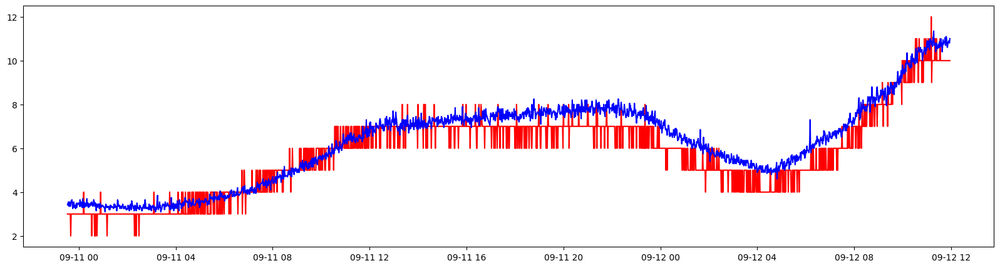

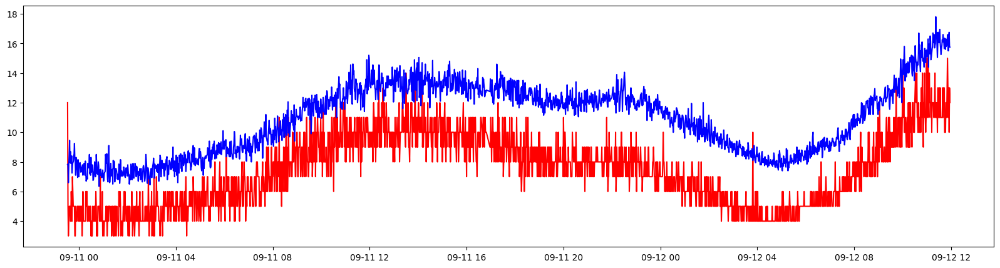

In [137]:
a2['PM2.5_shift'] = a2['PM2.5_shift'].shift(0)
a2['PM10_shift'] = a2['PM10_shift'].shift(0)

a2 = a2.dropna()
x = a2['created_at']
z_1 = a2['PM2.5_ppb']
z_2 = a2['PM2.5_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_1,'r')
plt.plot(x,z_2,'b')

x = a2['created_at']
z_3 = a2['PM10_ppb']
z_4 = a2['PM10_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_3,'r')
plt.plot(x,z_4,'b')

In [138]:
npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_1 - z_1.mean(), z_2 - z_2.mean(), mode='full')
ccor = ccov / (npts * z_1.std() * z_2.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('',Node[i],'')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_2, z_1)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_2, z_1)
MAE = mean_absolute_error(z_2, z_1)
print("MSE PM2.5: ", MSE)
print("MAE PM2.5: ", MAE)
print("RMSE PM2.5: ", np.sqrt(mean_squared_error(z_2, z_1)))

npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_3 - z_3.mean(), z_4 - z_4.mean(), mode='full')
ccor = ccov / (npts * z_3.std() * z_4.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('',Node[i],'')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_4, z_3)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_4, z_3)
MAE = mean_absolute_error(z_4, z_3)
print("MSE PM10: ", MSE)
print("MAE PM10: ", MAE)
print("RMSE PM10: ", np.sqrt(mean_squared_error(z_4, z_3)))

max correlation is at lag 0
max correlation is  0.956
Pearsons correlation: 0.957
MSE PM2.5:  0.5264498504371836
MAE PM2.5:  0.5936415094339623
RMSE PM2.5:  0.7255686393699659
max correlation is at lag 0
max correlation is  0.864
Pearsons correlation: 0.864
MSE PM10:  13.673323389783711
MAE PM10:  3.491663138518178
RMSE PM10:  3.697745717296379


In [139]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
X = a2['PM2.5_shift']
y = a2['PM2.5_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')

Coefficients:  [0.93337352]
Intercept:  -0.05835360368356124
R2  0.9042735680466865
MAE of simple linear regression of  0.43660961125834685
MSE of simple linear regression 0.319671899891804
RMSE of simple linear regression 0.565395348311077
Test data Spearman correlation of simple linear regression: 0.931


In [140]:
X = a2['PM10_shift']
y = a2['PM10_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')

Coefficients:  [0.87284976]
Intercept:  -2.0812237887067226
R2  0.7464101913139118
MAE of simple linear regression of  0.956393287059691
MSE of simple linear regression 1.4424512634268694
RMSE of simple linear regression 1.2010209254741857
Test data Spearman correlation of simple linear regression: 0.867


NODE-9

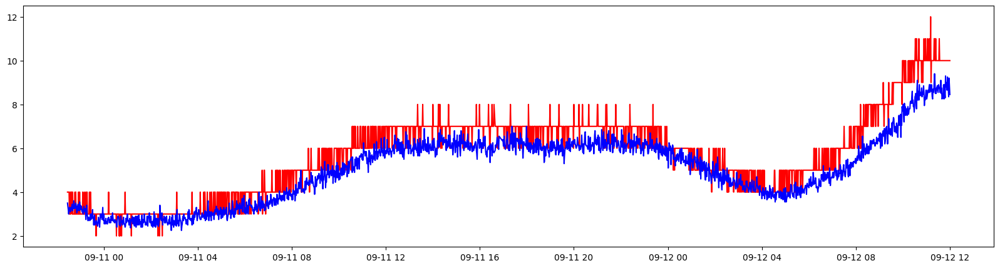

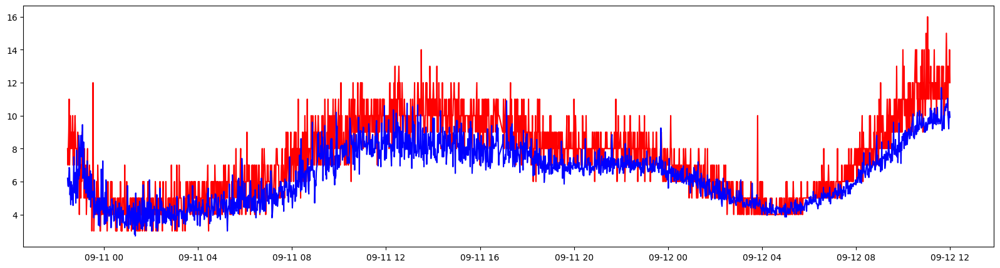

In [130]:
a9 = reduce(lambda x,y: pd.merge(x,y, on='created_at', how='inner'), [aero, BN9])
a9 = a9.dropna()
x = a9['created_at']
n1 = a9['PM2.5_ppb']
n2 = a9['PM2.5']
fig = plt.figure(figsize=(20,5))
plt.plot(x,n1,'r')
plt.plot(x,n2,'b')

x = a9['created_at']
n3 = a9['PM10_ppb']
n4 = a9['PM10']
fig = plt.figure(figsize=(20,5))
plt.plot(x,n3,'r')
plt.plot(x,n4,'b')

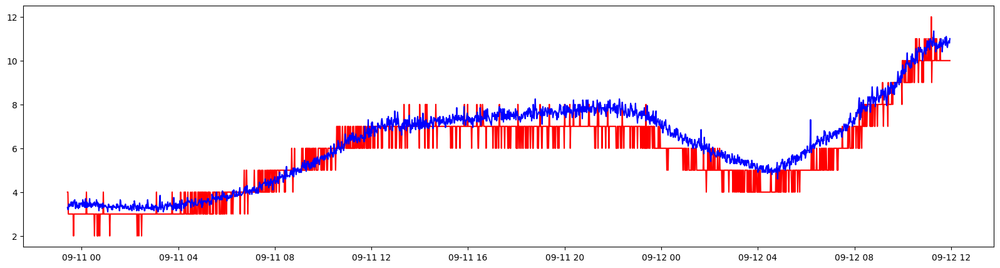

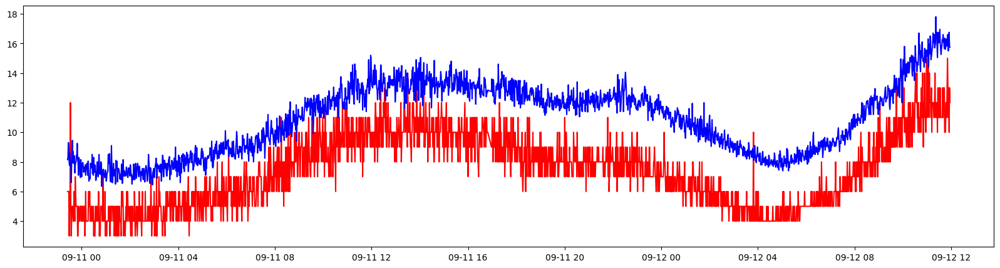

In [133]:
a2['PM2.5_shift'] = a2['PM2.5'].shift(0)
a2['PM10_shift'] = a2['PM10'].shift(7)

a2 = a2.dropna()
x = a2['created_at']
z_1 = a2['PM2.5_ppb']
z_2 = a2['PM2.5_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_1,'r')
plt.plot(x,z_2,'b')

x = a2['created_at']
z_3 = a2['PM10_ppb']
z_4 = a2['PM10_shift']
fig = plt.figure(figsize=(20,5))
plt.plot(x,z_3,'r')
plt.plot(x,z_4,'b')

In [134]:
npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_1 - z_1.mean(), z_2 - z_2.mean(), mode='full')
ccor = ccov / (npts * z_1.std() * z_2.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('',Node[i],'')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_2, z_1)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_2, z_1)
MAE = mean_absolute_error(z_2, z_1)
print("MSE PM2.5: ", MSE)
print("MAE PM2.5: ", MAE)
print("RMSE PM2.5: ", np.sqrt(mean_squared_error(z_2, z_1)))

npts = len(a2)
lags = np.arange(-npts + 1, npts)
lag.append(lags)
ccov = np.correlate(z_3 - z_3.mean(), z_4 - z_4.mean(), mode='full')
ccor = ccov / (npts * z_3.std() * z_4.std())
correlation.append(ccor)
maxlag = lags[np.argmax(ccor)]
#print('',Node[i],'')
print("max correlation is at lag %d" % maxlag)
print("max correlation is ", round(max(ccor),3))
corr, _ = pearsonr(z_4, z_3)
print('Pearsons correlation: %.3f' % corr)
MSE = mean_squared_error(z_4, z_3)
MAE = mean_absolute_error(z_4, z_3)
print("MSE PM10: ", MSE)
print("MAE PM10: ", MAE)
print("RMSE PM10: ", np.sqrt(mean_squared_error(z_4, z_3)))

max correlation is at lag 0
max correlation is  0.957
Pearsons correlation: 0.957
MSE PM2.5:  0.5255942775229357
MAE PM2.5:  0.5932490825688073
RMSE PM2.5:  0.7249788117751689
max correlation is at lag 0
max correlation is  0.864
Pearsons correlation: 0.864
MSE PM10:  13.663652438073395
MAE PM10:  3.4905509174311926
RMSE PM10:  3.6964378038962584


In [149]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
X = a2['PM2.5_shift']
y = a2['PM2.5_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')

Coefficients:  [0.93065384]
Intercept:  -0.042452832951062724
R2  0.9167328667971646
MAE of simple linear regression of  0.4070247392899878
MSE of simple linear regression 0.29492540036118947
RMSE of simple linear regression 0.5430703456838621
Test data Spearman correlation of simple linear regression: 0.939


In [150]:
X = a2['PM10_shift']
y = a2['PM10_ppb']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state= 0)
regressor = LinearRegression()
regressor.fit(X_train.values.reshape(-1,1), y_train)

print ('Coefficients: ', regressor.coef_)
print ('Intercept: ',regressor.intercept_)

test_y_hat = regressor.predict(X_test.values.reshape(-1,1))
ssr = np.sum((test_y_hat - y_test)**2)
ssr

    #  total sum of squares
sst = np.sum((y_test - np.mean(y_test))**2)
sst

    # R2 score
r2 = 1 - (ssr/sst)
print("R2 ", r2)

    # MAE
print("MAE of simple linear regression of ", metrics.mean_absolute_error(y_test,test_y_hat))

    #MSE
print("MSE of simple linear regression", mean_squared_error(y_test, test_y_hat))

   #RMSE
print("RMSE of simple linear regression", np.sqrt(mean_squared_error(y_test, test_y_hat)))

spearman = spearmanr(y_test, test_y_hat)
spearman1 = spearmanr(X_train.values.reshape(-1,1), y_train)
print(f'Test data Spearman correlation of simple linear regression: {spearman[0]:.3}')

    #print(f'Train data Spearman correlation of simple linear regression: {spearman1[0]:.3}')

Coefficients:  [0.87784588]
Intercept:  -2.1703092122762246
R2  0.7533118281877141
MAE of simple linear regression of  0.9665472779768666
MSE of simple linear regression 1.4184569879206437
RMSE of simple linear regression 1.1909899193194893
Test data Spearman correlation of simple linear regression: 0.863


# Plotting Calibrated data

In [151]:
import plotly.express as px
import pandas as pd

# Define function to calculate modified values
def calculate_values(df, m_pm25, c_pm25, m_pm10, c_pm10):
    df['PM2.5_c'] = df['PM2.5'] * m_pm25 + c_pm25
    df['PM10_c'] = df['PM10'] * m_pm10 + c_pm10
    return df

# Define coefficients for each file
coefficients = {


    'bn_1_without_outliers': {'m_pm25': 1.11189465, 'c_pm25': -0.15577177270931664 , 'm_pm10': 0.97416302, 'c_pm10': -2.4058939389444767},
    'bn_2_without_outliers': {'m_pm25': 0.93152129, 'c_pm25': -0.049442627336018674, 'm_pm10': 0.87536591, 'c_pm10': -2.120042654595153},
    'bn_3_without_outliers': {'m_pm25': 0.93065384, 'c_pm25': -0.042452832951062724, 'm_pm10': 0.87536591, 'c_pm10': -2.120042654595153},
    'bn_4_without_outliers': {'m_pm25': 0.93084436, 'c_pm25': -0.045761234323306255, 'm_pm10': 0.87678714, 'c_pm10': -2.1691424052292527},
    'bn_5_without_outliers': {'m_pm25': 0.93077389, 'c_pm25': -0.034799102852463015, 'm_pm10': 0.89324961, 'c_pm10': -2.3226766645912846},
    'bn_6_without_outliers': {'m_pm25': 0.93128634, 'c_pm25': -0.043879447982766884, 'm_pm10': 0.88188346, 'c_pm10': -2.195154621113316},
    'bn_7_without_outliers': {'m_pm25': 0.92966884, 'c_pm25': -0.025512297304354448, 'm_pm10': 0.88192438, 'c_pm10': -2.1914641608585033},
    'bn_8_without_outliers': {'m_pm25': 0.93337352, 'c_pm25': -0.05835360368356124, 'm_pm10': 0.87284976, 'c_pm10': -2.0812237887067226},
    'bn_9_without_outliers': {'m_pm25': 0.93065384, 'c_pm25': -0.042452832951062724, 'm_pm10': 0.87784588, 'c_pm10': -2.1703092122762246},

}

# Applying coefficients for each file and saving calibrated data
filepaths = ['/content/bn_1_without_outliers.csv', '/content/bn_2_without_outliers.csv', '/content/bn_3_without_outliers.csv', '/content/bn_4_without_outliers.csv', '/content/bn_5_without_outliers.csv', '/content/bn_6_without_outliers.csv', '/content/bn_7_without_outliers.csv', '/content/bn_8_without_outliers.csv', '/content/bn_9_without_outliers.csv']

for filepath in filepaths:
    name_without_extension = filepath.split('/')[-1].split('.')[0]

    # Load data
    hourly_data = pd.read_csv(filepath, parse_dates=['created_at'])

    # Extract coefficients
    if name_without_extension in coefficients:
        coeff = coefficients[name_without_extension]
        m_pm25, c_pm25, m_pm10, c_pm10 = coeff['m_pm25'], coeff['c_pm25'], coeff['m_pm10'], coeff['c_pm10']
    else:
        raise ValueError(f"Unknown file: {name_without_extension}")

    # Calculate modified data
    hourly_data_modified = calculate_values(hourly_data, m_pm25, c_pm25, m_pm10, c_pm10)

    # Save calibrated data to CSV
    calibrated_filename = f'{name_without_extension}_calibrated_hourly.csv'
    hourly_data_modified.to_csv(calibrated_filename, index=False)
    print(f"Calibrated data for {name_without_extension} saved as {calibrated_filename}")

    # Plotting modified data
    fig = px.line(hourly_data_modified, x='created_at',
                  y=['PM2.5_c', 'PM10_c'],
                  title=f'Hourly Averages with Coefficients - {name_without_extension}')

    # Add range slider
    fig.update_layout(xaxis=dict(
        tickformat='%d %b',
        tickmode='linear',
        tick0=hourly_data_modified['created_at'].iloc[0],
        dtick='12H',
        tickangle=0,
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1d", step="day", stepmode="backward"),
                dict(count=7, label="1w", step="day", stepmode="backward"),
                dict(count=1, label="1m", step="month", stepmode="backward"),
                # dict(count=1, label="1y", step="year", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(
            visible=True
        )
    ))

    # Increase the width of the plot
    fig.update_layout(width=1000)  # Adjust the width as needed

    fig.show()

    # Save plot as HTML
    fig.write_html(f"{name_without_extension}_calibrated_hourly_plot.html")


Calibrated data for bn_1_without_outliers saved as bn_1_without_outliers_calibrated_hourly.csv


/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



Calibrated data for bn_2_without_outliers saved as bn_2_without_outliers_calibrated_hourly.csv


/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



Calibrated data for bn_3_without_outliers saved as bn_3_without_outliers_calibrated_hourly.csv


/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



Calibrated data for bn_4_without_outliers saved as bn_4_without_outliers_calibrated_hourly.csv


/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



Calibrated data for bn_5_without_outliers saved as bn_5_without_outliers_calibrated_hourly.csv


/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



Calibrated data for bn_6_without_outliers saved as bn_6_without_outliers_calibrated_hourly.csv


/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



Calibrated data for bn_7_without_outliers saved as bn_7_without_outliers_calibrated_hourly.csv


/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



Calibrated data for bn_8_without_outliers saved as bn_8_without_outliers_calibrated_hourly.csv


/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



Calibrated data for bn_9_without_outliers saved as bn_9_without_outliers_calibrated_hourly.csv


/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [152]:
import plotly.express as px
import pandas as pd

# Dictionary to store HTML plots
html_plots = {}

# List to store filenames for HTML plots
html_filenames = []

# Define function to calculate modified values
def calculate_values(df, m_pm25, c_pm25, m_pm10, c_pm10):
    df['PM2.5_c'] = df['PM2.5'] * m_pm25 + c_pm25
    df['PM10_c'] = df['PM10'] * m_pm10 + c_pm10
    return df

# Loop through parameters
for parameter in ['PM2.5_c', 'PM10_c']:
    fig = px.line(title=f'{parameter} Data')

    # Loop through uploaded files
    for filepath in filepaths:
        name_without_extension = filepath.split('/')[-1].split('.')[0]

        # Extract coefficients
        if name_without_extension in coefficients:
            coeff = coefficients[name_without_extension]
            m_pm25, c_pm25, m_pm10, c_pm10 = coeff['m_pm25'], coeff['c_pm25'], coeff['m_pm10'], coeff['c_pm10']
        else:
            raise ValueError(f"Unknown file: {name_without_extension}")

        # Load data
        hourly_data = pd.read_csv(filepath, parse_dates=['created_at'])

        # Calculate modified data
        hourly_data_modified = calculate_values(hourly_data, m_pm25, c_pm25, m_pm10, c_pm10)

        # Add trace to the plot using modified columns
        fig.add_scatter(x=hourly_data_modified['created_at'], y=hourly_data_modified[parameter],
                        mode='lines', name=name_without_extension)

    # Update layout
    fig.update_layout(xaxis_title='Time', yaxis_title=parameter, width=1000,
                      xaxis=dict(
                          tickformat='%d %b',
                          tickmode='linear',
                          tick0=hourly_data_modified['created_at'].iloc[0],
                          dtick='12H',
                          tickangle=0,
                          rangeselector=dict(
                              buttons=list([
                                  dict(count=1, label="1d", step="day", stepmode="backward"),
                                  dict(count=7, label="1w", step="day", stepmode="backward"),
                                  dict(count=1, label="1m", step="month", stepmode="backward"),
                                  # dict(count=1, label="1y", step="year", stepmode="backward"),
                                  dict(step="all")
                              ])
                          ),
                          rangeslider=dict(
                              visible=True
                          )
                      )
                      )

    fig.show()

    # Save plot as HTML
    html_content = fig.to_html(full_html=False, include_plotlyjs='cdn')
    html_plots[parameter] = html_content

    html_filename = f"{parameter}_data_plot.html"
    with open(html_filename, 'w') as f:
        f.write(html_content)
    html_filenames.append(html_filename)

# Display HTML filenames
print("HTML plots saved as:")
for filename in html_filenames:
    print(filename)


/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/usr/local/lib/python3.10/dist-packages/

/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/usr/local/lib/python3.10/dist-packages/

HTML plots saved as:
PM2.5_c_data_plot.html
PM10_c_data_plot.html


# Plotting Aero + Nodes Calibrated data

In [153]:
import plotly.express as px
import pandas as pd

# Load the calibrated data for the outdoor nodes
n1 = pd.read_csv('/content/bn_1_without_outliers_calibrated_hourly.csv', parse_dates=['created_at'])
n2 = pd.read_csv('/content/bn_2_without_outliers_calibrated_hourly.csv', parse_dates=['created_at'])
n3 = pd.read_csv('/content/bn_3_without_outliers_calibrated_hourly.csv', parse_dates=['created_at'])
n4 = pd.read_csv('/content/bn_4_without_outliers_calibrated_hourly.csv', parse_dates=['created_at'])
n5 = pd.read_csv('/content/bn_4_without_outliers_calibrated_hourly.csv', parse_dates=['created_at'])
n6 = pd.read_csv('/content/bn_4_without_outliers_calibrated_hourly.csv', parse_dates=['created_at'])
n7 = pd.read_csv('/content/bn_4_without_outliers_calibrated_hourly.csv', parse_dates=['created_at'])
n8 = pd.read_csv('/content/bn_4_without_outliers_calibrated_hourly.csv', parse_dates=['created_at'])
n9 = pd.read_csv('/content/bn_4_without_outliers_calibrated_hourly.csv', parse_dates=['created_at'])

# Load the modified Aero data
aero = pd.read_csv('/content/modified_aero.csv', parse_dates=['created_at'])

# Create a figure for PM2.5
fig_pm25 = px.line(title='Outdoor Nodes - PM2.5')
fig_pm25.add_scatter(x=n1['created_at'], y=n1['PM2.5_c'], name='SDS_1')
fig_pm25.add_scatter(x=n2['created_at'], y=n2['PM2.5_c'], name='SDS_2')
fig_pm25.add_scatter(x=n3['created_at'], y=n3['PM2.5_c'], name='SDS_3')
fig_pm25.add_scatter(x=n4['created_at'], y=n4['PM2.5_c'], name='SDS_4')
fig_pm25.add_scatter(x=n5['created_at'], y=n5['PM2.5_c'], name='SDS_5')
fig_pm25.add_scatter(x=n6['created_at'], y=n6['PM2.5_c'], name='SDS_6')
fig_pm25.add_scatter(x=n7['created_at'], y=n7['PM2.5_c'], name='SDS_7')
fig_pm25.add_scatter(x=n8['created_at'], y=n8['PM2.5_c'], name='SDS_8')
fig_pm25.add_scatter(x=n9['created_at'], y=n9['PM2.5_c'], name='SDS_9')
fig_pm25.add_scatter(x=aero['created_at'], y=aero['PM2.5_ppb'], name='Aero')
fig_pm25.show()

# Create a figure for PM10
fig_pm10 = px.line(title='Outdoor Nodes - PM10')
fig_pm10.add_scatter(x=n1['created_at'], y=n1['PM10_c'], name='SDS_1')
fig_pm10.add_scatter(x=n2['created_at'], y=n2['PM10_c'], name='SDS_2')
fig_pm10.add_scatter(x=n3['created_at'], y=n3['PM10_c'], name='SDS_3')
fig_pm10.add_scatter(x=n4['created_at'], y=n4['PM10_c'], name='SDS_4')
fig_pm10.add_scatter(x=n5['created_at'], y=n5['PM10_c'], name='SDS_5')
fig_pm10.add_scatter(x=n6['created_at'], y=n6['PM10_c'], name='SDS_6')
fig_pm10.add_scatter(x=n7['created_at'], y=n7['PM10_c'], name='SDS_7')
fig_pm10.add_scatter(x=n8['created_at'], y=n8['PM10_c'], name='SDS_8')
fig_pm10.add_scatter(x=n9['created_at'], y=n9['PM10_c'], name='SDS_9')
fig_pm10.add_scatter(x=aero['created_at'], y=aero['PM10_ppb'], name='Aero')
fig_pm10.show()


/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [154]:

fig_1 = go.Figure()
fig_1.add_trace(go.Scatter(x=bn1['created_at'], y=bn1['PM2.5'], name='n1'))
fig_1.add_scatter(x=n1['created_at'], y=n1['PM2.5_c'], name='n1_c')
fig_1.add_scatter(x=aero['created_at'], y=aero['PM2.5_ppb'], name='Aero')

fig_1.update_layout(title='1 Raw vs Calibrated data PM2.5')
fig_1.update_xaxes()
fig_1.show()






